<div style="font-variant: small-caps; 
      font-weight: normal; 
      font-size: 35px; 
      text-align: center; 
      padding: 15px; 
      margin: 10px;">
  Nuclear Incidents
  </div> 

  
<div style="font-variant: small-caps; 
      font-weight: normal; 
      font-size: 25px; 
      text-align: center; 
      padding: 15px; 
      margin: 10px;">
      Classification - NER - Similarity
  </div> 


  <div style="
      font-size: 15px; 
      line-height: 15px; 
      text-align: center; 
      padding: 10px 15px 8px;">
  Jean-baptiste AUJOGUE
  </div> 

<a id="TOC"></a>

***
<div style="font-weight: normal; 
      font-size: 25px; 
      text-align: center; 
      padding: 15px; 
      margin: 10px;">
      Table of Content
  </div> 


**I** - [**Data structuration**](#structuration)

**II** - [**Text Classification**](#classification)<br>

$\qquad 1.$ [Formation of incident categories](#class_clustering)<br>
$\qquad 2.$ [Prediction of incident categories](#class_ml)<br>

**III** - [**Unsupervised NER**](#ner_unsupervised)<br>

$\qquad 1.$ [Discovery of Open-domain Entities](#entity_discovery)<br>
$\qquad 2.$ [Formation of entity categories](#entity_clustering)<br>
$\qquad 3.$ [Unsupervised Recognition of Named Entities](#entity_recognition_unsupervised)<br>
$\qquad 4.$ [Category interpretation](#entity_interpretation)<br>
$\qquad 5.$ [Supervised Recognition of Named Entities](#entity_recognition_supervised)<br>

**IV** - [**Text similarity**](#sim)<br>

$\qquad 1.$ [Tf-idf Text similarity](#sim_tfidf)<br>


[Bottom](#bottom)



In [1]:
from __future__ import unicode_literals, print_function, division
import sys
import warnings
import os
from io import open, BytesIO
import unicodedata
import string
import time
import datetime
import math
import re
import random
import copy
from unidecode import unidecode
import itertools
from dateutil.parser import parse
from ast import literal_eval # transforms back stings into list of words
import dill

# for manipulating data 
import numpy as np
import pandas as pd
from scipy.sparse import hstack, vstack

# for clustering
from sklearn.decomposition import PCA, NMF, LatentDirichletAllocation, TruncatedSVD
from sklearn.cluster import SpectralClustering, DBSCAN

# for classification
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.calibration import CalibratedClassifierCV
from sklearn import metrics
from catboost import CatBoostClassifier, CatBoostRegressor, Pool, cv

# for ner
from spacy.lang.en.stop_words import STOP_WORDS as en_stop
from spacy.lang.fr.stop_words import STOP_WORDS as fr_stop
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline, FeatureUnion
from sklearn.linear_model import SGDClassifier
from sklearn import metrics
import spacy
from spacy import displacy
from spacy.tokens import Span

# for text similarity
from sklearn.preprocessing import normalize

# for visualization
from IPython.core.display import display, HTML
from tqdm import tnrange
import seaborn as sns
import matplotlib.pyplot as plt
import altair as alt
import eli5 # pip install h5py==2.8.0 !!!

warnings.filterwarnings("ignore")
print('python version :', sys.version)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.metrics.scorer module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:143: FutureWarning: The sklearn.feature_selection.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.feature_selection. Anything that cannot be imported from sklearn.feature_selection is now part of the private API.
  warnings.warn(message, FutureWarning)


python version : 3.8.3 (default, Jul  2 2020, 17:30:36) [MSC v.1916 64 bit (AMD64)]


**Path to data repertory**

In [2]:
path_to_repo = os.path.dirname(os.getcwd())
path_to_data = os.path.join(path_to_repo, 'data')
path_to_save = os.path.join(path_to_repo, 'saves')

In [3]:
path_to_repo

'C:\\Users\\jbaujogue\\Desktop\\Tessella\\Internal - Nuclear Incidents'

<a id="structuration"></a>

# I - Data structuration

[Table of content](#TOC)



#### Data import

In [4]:
df_incidents = pd.read_excel(os.path.join(path_to_data, 'data_nuclear_incidents.xlsx'))
df_incidents = df_incidents[['text']]
df_incidents.shape

(1527, 1)

In [5]:
print(df_incidents.iloc[0, 0])

Non-respect d’une règle de maîtrise de la criticité. 
La société Framatome a déclaré le 20 avril 2021à l’Autorité de sûreté nucléaire (ASN) un événement significatif relatif à la maîtrise du risque de criticité[1].
L’événement est survenu dans l’usine de fabrication de combustible située sur la commune de Romans-sur-Isère (Drôme), dans l’installation nucléaire de base (INB) n° 98, dédiée à la fabrication d'éléments combustibles standards utilisés dans les réacteurs à eau sous pression. La matière nucléaire utilisée dans cette installation est de l'uranium à un taux d’enrichissement maximal de 5 %.
Dans cette installation, un réseau centralisé permet d’aspirer les particules fines de matière uranifère présente dans les équipements. Cette matière doit ensuite être tamisée afin de séparer la matière uranifère réutilisable des autres résidus collectés. Avant tamisage, la matière est entreposée en bouteillons, sur des emplacements dédiés et verrouillés au sol. Ces bouteillons doivent ensuit

#### Incident titles

In [6]:
df_incidents['title'] = df_incidents['text'].apply(lambda t: t.split('\n')[0])
df_incidents['text']  = df_incidents['text'].apply(lambda t: '\n'.join(t.split('\n')[1:]))

In [7]:
df_incidents.head()

,text,title
0,La société Framatome a déclaré le 20 avril 202...,Non-respect d’une règle de maîtrise de la crit...
1,"Le 7 avril 2021, l’exploitant de la centrale n...",Non-respect des spécifications techniques d’ex...
2,La société Framatome a déclaré le 13 avril 202...,Non-respect d’une consigne de maîtrise de la c...
3,"Dans la nuit du 4 au 5 avril 2021, EDF a infor...",Incendie du transformateur principal du réacte...
4,"Le 24 mars 2021, l’exploitant de la centrale n...",Détection tardive de l’indisponibilité du syst...


#### Date and location

In [ ]:
# 450 MB transformer-based model
nlp_en = spacy.load('en_core_web_trf')

# Merge multi-word entities into single tokens
nlp_en.add_pipe("merge_entities")

In [317]:
# an example
text = df_incidents.text[1]
doc = nlp_en(text)

displacy.render(doc, style = "ent", jupyter = True)

In [477]:
titles = df_incidents['title'].tolist()
texts  = df_incidents.text.tolist()

common_entities = []
for i in tnrange(len(texts)):
    title = titles[i]
    text = texts[i]
    ents = nlp_en(title + '\n' + text).ents
    common_entities.append(ents)

In [478]:
dates = [[ent.text for ent in ents if ent.label_ == 'DATE'] for ents in common_entities]
dates = [ds[0].replace('2021à', '2021') if len(ds)>0 else None for ds in dates]

In [479]:
dates

['le 20 avril 2021',
 'Le 7 avril 2021',
 'le 13 avril 2021',
 '4 au 5 avril 2021',
 'Le 24 mars 2021',
 'Le 17 mars 2021',
 'Le 11 mars 2021',
 'le 3 novembre 2020',
 'Le 14 janvier 2021',
 'le 19 mars 2021',
 'Le 18 mars 2021',
 'Le 9 mars 2021',
 'Le 8 mars 2021',
 'Le 2 mars 2021',
 'Le 17 février 2021',
 'Le 24 février 2021',
 'Le 8 février 2021',
 'Le 21 février 2021',
 'Le 19 février 2021',
 'le 22 février 2021',
 'Le 16 février 2021',
 'Le 5 février 2021',
 'Le 3 février 2021',
 'Le 20 janvier 2021',
 'Le 12 janvier 2021',
 'Le 13 janvier 2021',
 'le 20 janvier 2021',
 'Le 19 janvier 2021',
 'Le 31 décembre 2020',
 'Le 31 décembre 2020',
 'Le 31 décembre 2020',
 'Le 14 décembre 2020',
 'Le 23 décembre 2020',
 'Le 15 décembre 2020',
 'Les 18 septembre 2020',
 'Le 16 décembre 2020',
 'Le 12 décembre 2020',
 'Le 11 décembre 2020',
 'Le 1er décembre 2020',
 'Le 24 novembre 2020',
 'Le 16 novembre 2020',
 'le 2 décembre 2020',
 'le 1er décembre 2020',
 'Le 6 novembre 2020',
 'Le 28 

In [480]:
df_incidents['date'] = dates

In [481]:
locations = [[ent for ent in ents if ent.label_ == 'GPE'] for ents in common_entities]

In [482]:
unique_locations = [loc.text for locs in locations for loc in locs]
unique_locations += ['Saint-Laurent-des-Eaux']
unique_locations = set(unique_locations)
unique_locations - set(['Areva NC', 'Aucun', 'Saint'])
unique_locations

{'Aucun',
 'Belgique',
 'Belleville',
 'Belleville-sur-Loire',
 'Blayais',
 'Bollène',
 'Brennilis',
 'Bugey',
 'Cadarache',
 'Canada',
 'Cattenom',
 'Cedra',
 'Chinon',
 'Chooz',
 'Civaux',
 'Cruas',
 'Cruas-Meysse',
 'Dagneux',
 'Dampierre',
 'Dampierre-en-Burly',
 'Dessel',
 'Drôme',
 'Fessenheim',
 'Flamanville',
 'Fontenay aux Roses',
 'Fontenay-aux-Roses',
 'France',
 'Fukushima',
 'Gard',
 'Golfech',
 'Gravelines',
 'Grenoble',
 'Haut –Rhin',
 'Haut-Rhin',
 'Isère',
 'Japon',
 'La Hague',
 'Lyon',
 'Manche',
 'Marcoule',
 'Marseille',
 'Narbonne',
 'Nogent',
 'Nogent-sur-Seine',
 'Paluel',
 'Paris',
 'Penly',
 'Pierrelatte',
 'Pouzauges',
 'Romans-sur-Isere',
 'Romans-sur-Isère',
 'Saclay',
 'Saint',
 'Saint-Alban',
 'Saint-Laurent-des-Eaux',
 'Seine-Saint-Denis',
 'Tchernobyl',
 'Tricastin',
 'Ukraine',
 'Vaucluse',
 'Vienne',
 'Vlissingen'}

In [483]:
infered_locations = [[(loc, text.count(loc)) for loc in unique_locations] for text in df_incidents.text]
infered_locations = [sorted(locs, key = lambda lc: lc[1], reverse = True)[0] for locs in infered_locations]
infered_locations = [lc[0] if lc[1]>0 else 'Inconnu' for lc in infered_locations]

In [486]:
len([loc for loc in infered_locations if loc == 'Inconnu'])

356

In [484]:
infered_locations

['Romans-sur-Isère',
 'Belleville-sur-Loire',
 'Romans-sur-Isère',
 'Paluel',
 'Saint-Laurent-des-Eaux',
 'Flamanville',
 'Cadarache',
 'Saclay',
 'Cadarache',
 'Romans-sur-Isère',
 'Marseille',
 'Civaux',
 'Tricastin',
 'Marcoule',
 'Flamanville',
 'Cattenom',
 'Bugey',
 'Cruas-Meysse',
 'Gravelines',
 'Saclay',
 'Chinon',
 'Cadarache',
 'Cattenom',
 'Bugey',
 'Inconnu',
 'Bugey',
 'Romans-sur-Isère',
 'Cruas-Meysse',
 'Tricastin',
 'Belleville',
 'Inconnu',
 'Nogent',
 'Bugey',
 'Gravelines',
 'Civaux',
 'Nogent',
 'Gravelines',
 'Belleville-sur-Loire',
 'Nogent',
 'Paluel',
 'Cruas-Meysse',
 'Inconnu',
 'Romans-sur-Isère',
 'Inconnu',
 'Dampierre-en-Burly',
 'Flamanville',
 'Cruas-Meysse',
 'Tricastin',
 'Inconnu',
 'Gravelines',
 'La Hague',
 'Paluel',
 'Pouzauges',
 'Flamanville',
 'Gravelines',
 'Dampierre-en-Burly',
 'Civaux',
 'Flamanville',
 'Bugey',
 'Cattenom',
 'Blayais',
 'Nogent',
 'Nogent',
 'Cattenom',
 'Chooz',
 'Gravelines',
 'Belleville-sur-Loire',
 'Blayais',
 'Palu

In [485]:
df_incidents['location'] = infered_locations

#### Export result

In [349]:
df_incidents.head()

,text,title,date,location
0,La société Framatome a déclaré le 20 avril 202...,Non-respect d’une règle de maîtrise de la crit...,le 20 avril 2021,Romans-sur-Isère
1,"Le 7 avril 2021, l’exploitant de la centrale n...",Non-respect des spécifications techniques d’ex...,Le 7 avril 2021,Belleville-sur-Loire
2,La société Framatome a déclaré le 13 avril 202...,Non-respect d’une consigne de maîtrise de la c...,le 13 avril 2021,Romans-sur-Isère
3,"Dans la nuit du 4 au 5 avril 2021, EDF a infor...",Incendie du transformateur principal du réacte...,4 au 5 avril 2021,Paluel
4,"Le 24 mars 2021, l’exploitant de la centrale n...",Détection tardive de l’indisponibilité du syst...,Le 24 mars 2021,Saint-Laurent-des-Eaux


In [350]:
df_incidents.to_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles.xlsx'), index = False)

<a id="classification"></a>

# II - Text Classification

[Table of Content](#TOC)

<a id="class_clustering"></a>

## 1. Formation of incident categories

[Table of Content](#TOC)

In [5]:
df_incidents = pd.read_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles.xlsx'))

### $\bullet$ Approach 1 - Clustering

In [8]:
# TODO

### $\bullet$ Approach 2 - Topic modeling

#### Compute stripped ngrams

In [57]:
def get_ngrams(texts, ngram_range):
    vectorizer = TfidfVectorizer(
        use_idf = True,
        ngram_range = (1, ngram_range),
        min_df = 1,
        lowercase = True,
        stop_words = [],
        strip_accents = None,
    ).fit(texts)
    
    ngrams = vectorizer.get_feature_names()
    return ngrams


def strip_ngrams_fr(ngrams) :
    ngrams_stripped = []
    ngrams.sort(key = len, reverse = True)
    for ngram in ngrams :
        cut = ngram.split()
        somehow_goods = [i for i, w in enumerate(cut) 
                 if w.lower() not in list(fr_stop) + ['le', 'la', 'l', 'les', 'de', 
                              'du', 'des', 'd', 's', 'se', 'ce', 'ces', 'cette', 
                              'un', 'une', 'et', 'avec']]
        goods = [i for i, w in enumerate(cut) 
                 if w.lower() not in list(fr_stop) + ['le', 'la', 'l', 'les', 'de', 
                              'du', 'des', 'd', 'en', 'est', 's', 'se',
                              'un', 'une', 'et', 'sur', 'pour', 
                              'avec', 'par', 'dans', 'a', 'à',  'au', 'aux']]
        if goods != [] : 
            ngram_stripped = ' '.join(cut[min(somehow_goods):max(goods)+1])
            ngrams_stripped.append(ngram_stripped)
            
    ngrams_stripped = list(set(ngrams_stripped))
    return ngrams_stripped

In [488]:
titles = df_incidents['title'].tolist()

ngrams = get_ngrams(titles, ngram_range = 3)
print(len(ngrams))

ngrams = strip_ngrams_fr(ngrams)
print(len(ngrams))

15525
6545


#### Perform Topic modeling

In [150]:
def get_topic_modeling(
    texts, 
    method = 'LSA', 
    n_components = None, 
    vocab = None,
    stop_words = [],
    return_model = False,
    ):
    if method not in ['PCA', 'LSA', 'LDA', 'NMF']:
        print('Invalid method (choose between PCA, LSA, LDA and NMF)')
        return

    # (text * feature) matrix
    vectorizer = TfidfVectorizer(
        sublinear_tf = True,
        use_idf = True,
        ngram_range = (1, 3),
        min_df = 3,
        stop_words = stop_words,
        strip_accents = None,
        lowercase = True,
    )
    vects = vectorizer.fit_transform(texts) # size (num_texts, num_features)
    feats = vectorizer.get_feature_names()
    
    # reduce feature size
    if vocab:
        inds = [i for i, w in enumerate(feats) if w in vocab]
        feats = [w for w in feats if w in vocab]
        vects = vects[:, inds]
    print('number of features : {}'.format(len(feats)))

    # (text * topic) matrix
    if method == 'PCA' : 
        model = PCA(
            n_components = n_components, 
            random_state = 42)
        text_topic = model.fit_transform(vects.todense())
        
    elif method == 'LSA' : 
        model = TruncatedSVD(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            n_iter = 10,
            random_state = 42)
        text_topic = model.fit_transform(vects)
        
    elif method == 'LDA' : 
        model = LatentDirichletAllocation(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            learning_offset = 50.,
            random_state = 42)
        text_topic = model.fit_transform(vects)
        
    elif method == 'NMF':
        model = NMF(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            beta_loss = 'kullback-leibler', 
            solver = 'mu', 
            #alpha = .1,
            #l1_ratio = .0,
            random_state = 42)
        text_topic = model.fit_transform(vects)
        
        
    topics = ['Topic ' + str(i+1) for i in range(text_topic.shape[1])]
    df_text_topic = pd.DataFrame(text_topic, columns = topics)

    # (topic * feature) matrix
    df_topic_feature = pd.DataFrame(np.round(model.components_, 4))
    df_topic_feature.columns = feats
    df_topic_feature.index = topics
    
    # topic importance
    try:
        eigenvalues = model.explained_variance_ratio_ #model.singular_values_ 
    except:
        eigenvalues = [1. for _ in range(model.components_.shape[0])]
    
    df_topic_importance = pd.DataFrame({
        'topic' : topics, 
        'weight': eigenvalues,
    })
    # feature importance
    feature_importance = abs(df_topic_feature.T).dot(eigenvalues)
    df_feature_importance = pd.DataFrame({
        'feature': feats, 
        'weight' : feature_importance,
    })
    if return_model:
        return (vectorizer, model, df_text_topic, df_topic_feature, df_topic_importance, df_feature_importance)
    else:
        return (df_text_topic, df_topic_feature, df_topic_importance, df_feature_importance)



def get_topic_description(df, n_topic = 1, limit = 10) :
    features = df.columns.tolist()
    topic = df.iloc[n_topic-1, :]
    if   isinstance(limit, int)   : indices = topic.argsort().tolist()[:-limit - 1:-1]
    elif isinstance(limit, float) : indices = [i for i in topic.argsort().tolist()[::-1] if topic[i] >= limit]
    word_sims = [[features[i], topic[i]] for i in indices]
    return word_sims

#### Explain topics

In [61]:
# see https://scikit-learn.org/stable/auto_examples/applications/plot_topics_extraction_with_nmf_lda.html
def plot_top_words(df_topic_feature, n_topics, n_top_words = 15, title = ''):
    feature_names = df_topic_feature.columns
    n_row_plots = int((n_topics-0.1)/3)+1
    fig, axes = plt.subplots(n_row_plots, 3, figsize = (25, 8*n_row_plots), sharex = True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(df_topic_feature.values[:n_topics,:]):
        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f'Topic {topic_idx +1}',
                     fontdict={'fontsize': 30})
        ax.invert_yaxis()
        ax.tick_params(axis='both', which='major', labelsize=20)
        for i in 'top right left'.split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=40)

    plt.subplots_adjust(top = 0.90, bottom = 0.05, wspace = 0.90, hspace = 0.3)
    return fig

#### Topic modeling using LSA

In [491]:
titles = df_incidents['title'].tolist()
(
    df_text_topic_LSA, 
    df_topic_feature_LSA, 
    df_topic_importance_LSA, 
    df_feature_importance_LSA,
) = get_topic_modeling(
    titles, 
    method = 'LSA', 
    vocab = ngrams,
)

number of features : 1417


In [ ]:
n_topics = 100
topic_LSA = df_text_topic_LSA.iloc[:, :n_topics].idxmax(axis = 1)

In [500]:
df_incidents['topic_LSA'] = topic_LSA

#### Interpretation of LSA topics

In [589]:
topic_LSA_dict = {
    1: "Non-respect des spécifications techniques d'exploitation",
    2: "Non-respect des règles générales d'exploitation",
    3: "Détection tardive d'indisponibilité",
    4: "Défaut d’isolement de l’enceinte de confinement",
    5: "Sortie du domaine de fonctionnement",
    6: "Incident de contamination",
    9: "Défaut du groupe électrogène de secours",
    10: "Défaut de maîtrise de la criticité",
    12: "Défaut de tenue au séisme",
    14: "Défaut du circuit d’injection de sécurité",
    16: "Défaut du turbo-alternateur de secours",
    17: "Non-respect d’une mesure compensatoire",
    18: "Défaut du circuit de refroidissement",
    20: "Défaut du circuit d’eau brute",
    21: "Défaut du groupe électrogène de secours",
    22: "Défaut du circuit de refroidissement",
    23: "Défaut de grappes de commande",
    24: "contamination d’outillages",
    28: "Rejets de fluide frigorigène",
    31: "Défaut de réalisation du contrôle périodique",
    34: "Surplus de matière uranifère",
    38: "Incident de contamination",
    39: "Défaut d’entreposage de déchets radioactifs",
    43: "Défaut de montée en puissance",
    52: "Défaut de détecteurs incendie",
    58: "Défaut du circuit de contrôle volumétrique et chimique",
}

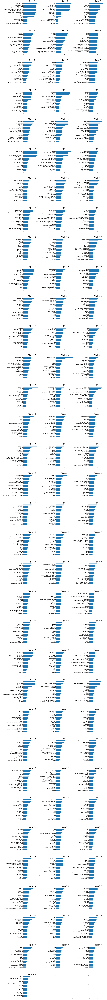

In [587]:
# LSA
plot_top_words(df_topic_feature_LSA, n_topics = 100, n_top_words = 15)

In [586]:
df_incidents[df_incidents.topic_LSA == 'Topic 73'].title.tolist()

['Risque de défaillance d’éléments importants pour la protection en cas de séisme. ',
 'Risque de défaillance d’éléments importants pour la protection en cas de séisme. ',
 'Anomalie relative au comportement d’une vanne en cas de séisme. ']

<AxesSubplot:>

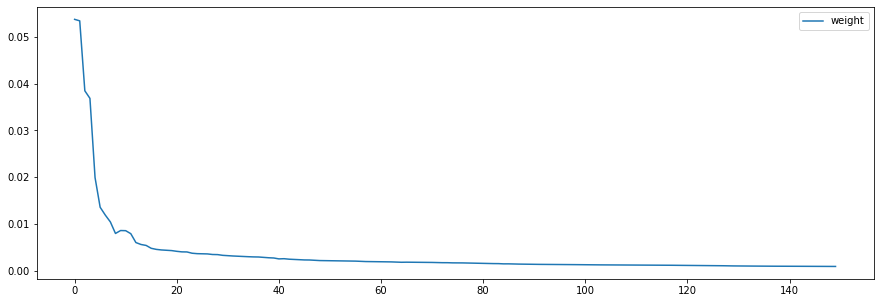

In [494]:
df_topic_importance.plot(figsize = (15, 5))

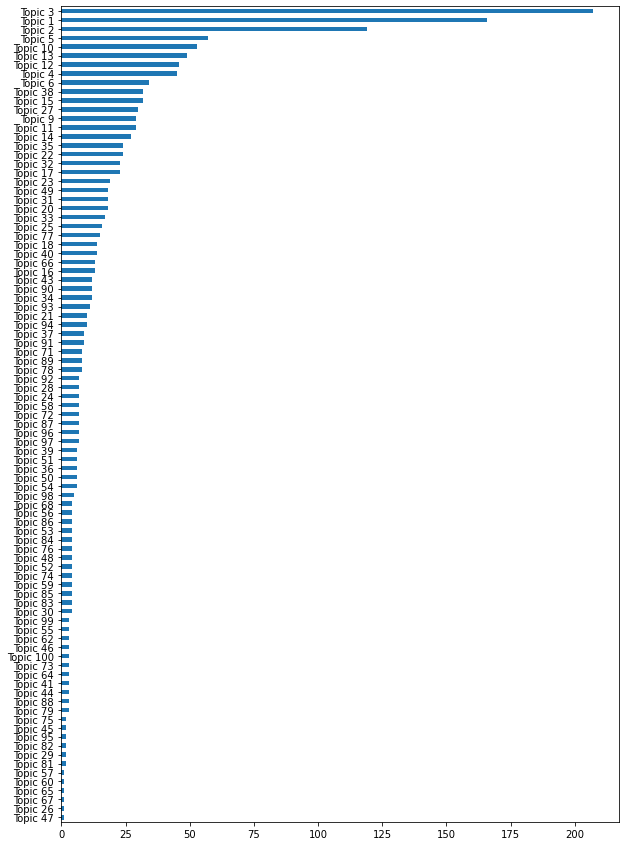

In [546]:
topic_LSA.value_counts().plot.barh(figsize = (10, 15)).invert_yaxis()
plt.show()

#### Topic modeling using NMF

In [495]:
titles = df_incidents['title'].tolist()
(
    df_text_topic_NMF, 
    df_topic_feature_NMF, 
    df_topic_importance_NMF, 
    df_feature_importance_NMF,
) = get_topic_modeling(
    titles, 
    method = 'NMF', 
    vocab = ngrams,
)

number of features : 1417


In [ ]:
n_topics = 100
topic_NMF = df_text_topic_NMF.iloc[:, :n_topics].idxmax(axis = 1)

In [502]:
df_incidents['topic_NMF'] = topic_NMF

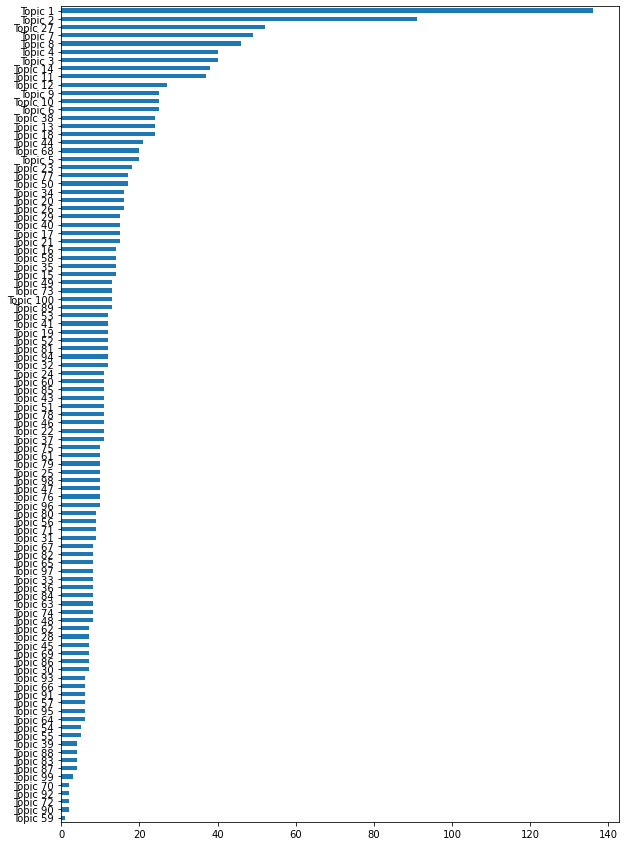

In [590]:
topic_NMF.value_counts().plot.barh(figsize = (10, 15)).invert_yaxis()
plt.show()

#### Interpretation of NMF topics

In [689]:
topic_NMF_dict = {
    1: "Non-respect des spécifications techniques d'exploitation",
    2: "Non-respect des règles générales d'exploitation",
    3: "Détection tardive d'indisponibilité",
    4: "Défaut d’isolement de l’enceinte de confinement",
    5: "Sortie du domaine de fonctionnement",
    6: "Incident de contamination radioactive",
    7: "circuit d’alimentation de secours des générateurs de vapeur",
    8: "Défaut de maîtrise de la criticité",
    9: "Défaut du groupe électrogène de secours",
    10: "Défaut de maîtrise de la criticité",
    12: "Défaut de tenue au séisme",
    13: "Défaut du système de ventilation",
    14: "Défaut du circuit d’injection de sécurité",
    16: "Défaut du turbo-alternateur de secours",
    17: "Non-respect d’une mesure compensatoire",
    18: "Défaut du circuit de refroidissement",
    19: "Défaut de tenue au séisme",
    20: "Défaut du circuit d’eau brute",
    21: "Défaut du groupe électrogène de secours",
    22: "Défaut du circuit de refroidissement",
    23: "Défaut de grappes de commande",
    24: "Sortie du domaine de fonctionnement",
    26: "Contamination par effluents radioactifs",
    28: "Rejets de fluide frigorigène",
    30: "Défaut de réalisation du contrôle périodique",
    31: "Défaut de réalisation du contrôle périodique",
    32: "Défaut d’alimentation électrique",
    34: "Surplus de matière uranifère",
    36: "Défaut de capteur",
    37: "Incident lors du redémarrage du réacteur",
    38: "Incident de contamination",
    39: "Défaut d’entreposage de déchets radioactifs",
    41: "Arret automatique du réacteur",
    45: "Défaut de montée en puissance",
    46: "Incident dans la piscine d’entreposage du combustible",
    51: "Dépassement de délai de réparation",
    52: "Non-respect des règles générales d'exploitation",
    54: "Défaut des systèmes de protection du réacteur",
    57: "Défaut du circuit secondaire",
    61: "du circuit de contrôle volumétrique et chimique",
    63: "Sortie du domaine de fonctionnement",
    71: "Défaut de tenue au séisme",
    72: "Non-respect des règles générales d'exploitation",
    77: "Défaut d’intégrité de barrière de confinement",
    78: "Défaut sur un générateur de vapeur",
    79: "Non-respect des règles générales d'exploitation",
    80: "Défaut de système de filtration d’iode",
    87: "Défaut de clapets coupe-feu",
    88: "Non-respect des règles générales d'exploitation",
}

In [687]:
df_incidents[df_incidents.topic_NMF == 'Topic 99'].title.tolist()

['Dysfonctionnement affectant un wagon transportant quatre colis d’uranium naturel appauvri. ',
 'Inétanchéité d’une tuyauterie contenant de l’oxyde d’uranium naturel appauvri à l’extérieur de l’atelier de défluoration d’AREVA NC de Pierrelatte (Drôme). ',
 'Incident affectant un transport d’uranium naturel appauvri par voie ferroviaire. ']

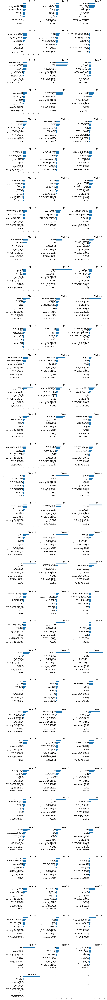

In [588]:
# NMF
plot_top_words(df_topic_feature_NMF, n_topics = 100, n_top_words = 15)

In [699]:
sub_topics = [i-1 for i in topic_NMF_dict.keys()]
topic_NMF_interpreted = df_text_topic_NMF.iloc[:, sub_topics].idxmax(axis = 1)
topic_NMF_interpreted = [topic_NMF_dict[int(topic.split()[-1])] for topic in topic_NMF_interpreted]

In [700]:
topic_NMF_interpreted[:10]

['Défaut de maîtrise de la criticité',
 "Non-respect des spécifications techniques d'exploitation",
 'Défaut de maîtrise de la criticité',
 'Arret automatique du réacteur',
 "Détection tardive d'indisponibilité",
 "Détection tardive d'indisponibilité",
 "Non-respect des spécifications techniques d'exploitation",
 'Contamination par effluents radioactifs',
 'Contamination par effluents radioactifs',
 'Surplus de matière uranifère']

In [701]:
df_incidents['topic_NMF_interpreted'] = topic_NMF_interpreted

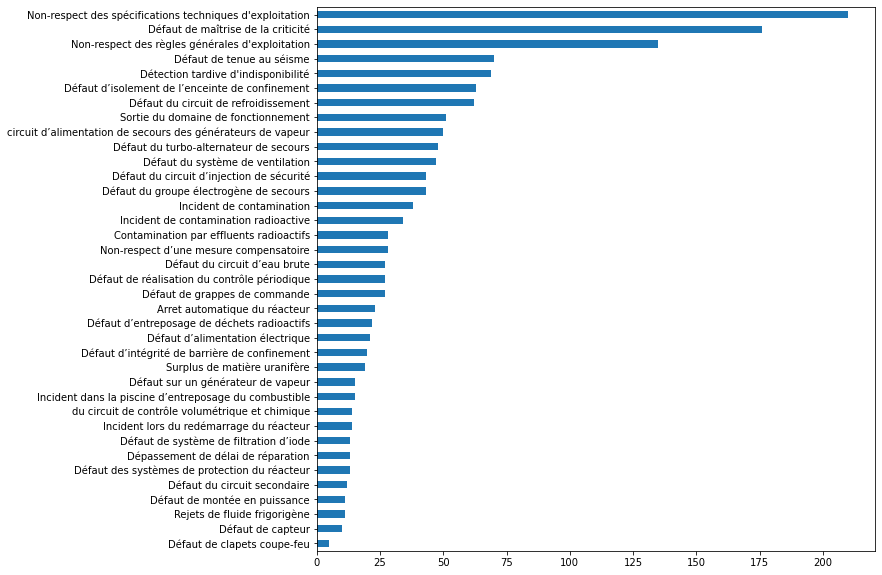

In [704]:
df_incidents['topic_NMF_interpreted'].value_counts().plot.barh(figsize = (10, 10)).invert_yaxis()
plt.show()

#### Export result

In [503]:
df_incidents.head(20)

,text,title,date,location,topic_LSA,topic_NMF
0,La société Framatome a déclaré le 20 avril 202...,Non-respect d’une règle de maîtrise de la crit...,le 20 avril 2021,Romans-sur-Isère,Topic 10,Topic 10
1,"Le 7 avril 2021, l’exploitant de la centrale n...",Non-respect des spécifications techniques d’ex...,Le 7 avril 2021,Belleville-sur-Loire,Topic 1,Topic 1
2,La société Framatome a déclaré le 13 avril 202...,Non-respect d’une consigne de maîtrise de la c...,le 13 avril 2021,Romans-sur-Isère,Topic 10,Topic 8
3,"Dans la nuit du 4 au 5 avril 2021, EDF a infor...",Incendie du transformateur principal du réacte...,4 au 5 avril 2021,Paluel,Topic 11,Topic 11
4,"Le 24 mars 2021, l’exploitant de la centrale n...",Détection tardive de l’indisponibilité du syst...,Le 24 mars 2021,Saint-Laurent-des-Eaux,Topic 3,Topic 3
5,"Le 17 mars 2021, EDF a déclaré à l’ASN un évén...",Détection de défauts affectant la qualificatio...,Le 17 mars 2021,Flamanville,Topic 96,Topic 83
6,"Le 11 mars 2021, le Commissariat à l’énergie a...",Intervention d’un opérateur au sein de l’INB 2...,Le 11 mars 2021,Cadarache,Topic 66,Topic 53
7,"CIS bio international, exploitant de l’INB n° ...",Entreposage non-autorisé d’effluents liquides ...,le 3 novembre 2020,Saclay,Topic 20,Topic 26
8,"Le 14 janvier 2021, l’Autorité de sûreté nuclé...",Chute d’un colis de déchets radioactifs dans u...,Le 14 janvier 2021,Cadarache,Topic 39,Topic 50
9,La société Framatome a déclaré le 19 mars 2021...,Dépassement de la limite de masse de matière u...,le 19 mars 2021,Romans-sur-Isère,Topic 34,Topic 34


In [705]:
df_incidents.to_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles_topics.xlsx'), index = False)

<a id="class_ml"></a>

## 2. Prediction of incident categories

[Table of Content](#TOC)

In [42]:
def get_code2num(y) :
    '''Takes the list of output labels to predict, and computes 2 dictionaries 
       code2num = {label : num}
       num2code = {num : label}
    '''
    if y is None : return None, None
    class_list = np.unique(y.values.tolist())
    code2num = {el : i for i, el in enumerate(class_list)}
    num2code = {i : el for i, el in enumerate(class_list)}
    return code2num, num2code



def split_dataset(df, train_size = 0.8, split_col = None):
    # get nans
    col_name = df.columns[-1]
    df_nan = df[df[col_name].isnull()]
    df = df[df[col_name].notnull()]
    
    # time-ordered train/test
    if split_col:
        values = df[split_col].unique().tolist()
        threshold = int(train_size * len(values))
        
        val2idx = {val: idx for idx, val in enumerate(values)}
        
        is_trn = df[split_col].apply(lambda val: val2idx[val] <= threshold)
        is_tst = df[split_col].apply(lambda val: val2idx[val] > threshold)
        df_trn = df[is_trn]
        df_tst = df[is_tst]

    # random train/test
    else:
        df_trn, df_tst = train_test_split(
            df, 
            train_size = train_size, 
            random_state = 42, 
            stratify = df[col_name],
        )
    return (df_trn, df_tst, df_nan)



def train_model(model, df_train, code2num, mode = None) :
    # check if each category has 4 or more samples for early stopping
    col_name = df_train.columns[-1]
    df_fews  = df_train[df_train.groupby(col_name)[col_name].transform('size') < 2]
    df_trn   = df_train.append(df_fews, ignore_index = True)
    df_fews  = df_trn[df_trn.groupby(col_name)[col_name].transform('size') < 4]
    df_trn   = df_trn.append(df_fews, ignore_index = True)
    df_fews  = df_trn[df_trn.groupby(col_name)[col_name].transform('size') < 8]
    df_trn   = df_trn.append(df_fews, ignore_index = True)
    
    if mode == 'catboost':
        # prepare data
        col_input, col_target = df_trn.columns.tolist()
        tickets = df_trn[[col_input]]
        targets = df_trn[col_target]
        targets = [code2num[code] for code in targets.values.tolist()]
        pool = Pool(data = tickets, label = targets, text_features = [col_input])
        # train model
        preds = model.fit(pool, plot = True)
    
    elif mode == 'bart':
        # prepare data
        tickets = df_trn.iloc[:, 0].tolist()
        targets = df_trn.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # embed data
        batch_size = 32
        embeddings = np.zeros((0, 1024))
        for i in range(0, len(tickets), batch_size):
            embs = model['vectorizer'].transform(tickets[i: i + batch_size])
            embeddings = np.concatenate((embeddings, embs), axis = 0)
        # train model
        model['classifier'].fit(embeddings, targets)
        print(len(model['vectorizer'].get_feature_names()), 'features')
        
    else:
        # prepare data
        tickets = df_trn.iloc[:, 0]
        targets = df_trn.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # train model
        model.fit(tickets, targets)
        print(len(model['vectorizer'].get_feature_names()), 'features')
    return model



def eval_model(model, df_test, code2num, mode = None):
    if mode == 'catboost':
        # prepare data
        col_input, col_target = df_test.columns.tolist()
        tickets = df_test[[col_input]]
        targets = df_test[col_target]
        targets = [code2num[code] for code in targets.values.tolist()]
        pool = Pool(data = tickets, label = targets, text_features = [col_input])
        # compute predictions
        preds = model.predict(pool).tolist()
    
    elif mode == 'bart':
        # prepare data
        tickets = df_test.iloc[:, 0].tolist()
        targets = df_test.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # embed data
        batch_size = 32
        embeddings = np.zeros((0, 1024))
        for i in range(0, len(tickets), batch_size):
            embs = model['vectorizer'].transform(tickets[i: i + batch_size])
            embeddings = np.concatenate((embeddings, embs), axis = 0)
        # compute predictions
        preds = model['classifier'].predict(embeddings).tolist()
        
    else:
        # prepare data
        tickets = df_test.iloc[:, 0]
        targets = df_test.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # compute predictions
        preds = model.predict(tickets).tolist()

    # compute scores
    nsamples = len(targets)
    accu = metrics.accuracy_score(targets, preds)
    recc = metrics.recall_score(targets, preds, average = 'weighted')
    spec = metrics.recall_score(preds, targets, average = 'weighted')
    prec = metrics.precision_score(targets, preds, average = 'weighted')

    report = metrics.classification_report(
        targets, 
        preds, 
        target_names = list(code2num.keys()),
    )
    return (nsamples, accu, recc, spec, prec, report)



def display_model_quality(model, df_train, df_test, code2num, mode = None):
    sample_total = df_train.shape[0] + df_test.shape[0]
    sample_train = df_train.shape[0]
    sample_test, accu, recc, spec, prec, report = eval_model(model, df_test, code2num, mode)

    print('The corpus totalizes', 
          sample_total, 
          'sentences.',
          '\nAmong these sentences,',
          sample_train,
          'are randomly selected for training, and the remaining',
          str(sample_test),
          'tickets are left for testing.',
          '\n\nThe trained model displays an accuracy of', 
          np.round(accu*100, 1), 
          '% on the test set.\n')
    print(report)
    return



def display_model_confusion(model, df_test, code2num, num2code, mode = None) :
    if mode == 'catboost':
        # prepare data
        col_input, col_target = df_test.columns.tolist()
        tickets = df_test[[col_input]]
        targets = df_test[col_target]
        targets = [code2num[code] for code in targets.values.tolist()]
        pool = Pool(data = tickets, label = targets, text_features = [col_input])
        # compute predictions
        preds = model.predict(pool).tolist()
    
    elif mode == 'bart':
        # prepare data
        tickets = df_test.iloc[:, 0].tolist()
        targets = df_test.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # embed data
        batch_size = 32
        embeddings = np.zeros((0, 1024))
        for i in range(0, len(tickets), batch_size):
            embs = model['vectorizer'].transform(tickets[i: i + batch_size])
            embeddings = np.concatenate((embeddings, embs), axis = 0)
        # compute predictions
        preds = model['classifier'].predict(embeddings).tolist()
        
    else:
        # prepare data
        tickets = df_test.iloc[:, 0]
        targets = df_test.iloc[:, 1]
        targets = [code2num[code] for code in targets.values.tolist()]
        # compute predictions
        preds = model.predict(tickets).tolist()
    
    # compute confusion
    codes = [num2code[i] for i in sorted(list(np.unique(targets + preds)))]
    conf_mat = metrics.confusion_matrix(targets, preds)

    # display matrix as heatmap
    fig, ax = plt.subplots(figsize = (20, 20))
    cbar_ax = fig.add_axes() # 
    sns.heatmap(
        conf_mat, ax = ax, square = True,
        cbar_ax = cbar_ax,
        annot = True, fmt = 'g', xticklabels = codes, yticklabels = codes,
    )
    plt.ylabel('True category')
    plt.xlabel('Predicted category')
    plt.subplots_adjust()
    plt.tight_layout()
    plt.show()
    return

In [51]:
def runAllPipe( 
        df,
        input_var,
        target_var, 
        model_type = 'linearSVC',
        vectorizer = None,
        split_col = None,
        retrain = False,
    ):
    if (model_type == 'catboost'):
        mode = 'catboost'
    elif vectorizer:
        mode = 'bart'
    else:
        mode = None
    
    # 1 prepare data
    code2num, num2code = get_code2num(df[[target_var]])

    df_train, df_test, df_nan = split_dataset(df, split_col = split_col)
    df_train = df_train[[input_var, target_var]]
    df_test  = df_test[[input_var, target_var]]

    # 2.1 Boosted Tree
    if model_type == 'catboost' :
        model = CatBoostClassifier(
            n_estimators = 200,
            random_seed = 42,
            loss_function = 'MultiClass', # "CrossEntropy", # 'Logloss'
            custom_loss = 'F1',
            logging_level = 'Silent',
        )
        
    # 2.2 linear SVC
    elif model_type == 'linear SVC' :
        classifier = SGDClassifier(
            loss = 'hinge', 
            penalty = 'l2',
            #early_stopping = True,
            #validation_fraction = 0.2,
            average = 5,
            class_weight = 'balanced',
            random_state = 42, 
            shuffle = True,
            n_jobs = -1,
        )
        if vectorizer:
            model = {'vectorizer': vectorizer, 'classifier': classifier}
        else:
            vectorizer = TfidfVectorizer(
                sublinear_tf = True,
                ngram_range = (1, 3),
                min_df = 3,
                max_features = 20000,
                strip_accents = 'unicode',
                lowercase = True,
                #token_pattern = r'\b[a-zA-Z]{1,1000}\b',
            )
            model = Pipeline([('vectorizer', vectorizer), ('classifier', classifier)])

    # 2.3 calibrated linear SVC
    elif model_type == 'calibrated linear SVC' :
        classifier = SGDClassifier(
            loss = 'hinge', 
            penalty = 'l2',
            #early_stopping = True,
            #validation_fraction = 0.2,
            average = 5,
            class_weight = 'balanced',
            random_state = 42, 
            shuffle = True,
            n_jobs = -1,
        )
        classifier = CalibratedClassifierCV(
            base_estimator = classifier,
            method = 'sigmoid', # 'sigmoid' or 'isotonic'
            cv = 5,
            #ensemble = True,
            #n_jobs = -1,
        )
        if vectorizer:
            model = {'vectorizer': vectorizer, 'classifier': classifier}
        else:
            vectorizer = TfidfVectorizer(
                sublinear_tf = True,
                ngram_range = (1, 3),
                min_df = 3,
                max_features = 20000,
                strip_accents = 'unicode',
                lowercase = True,
                #token_pattern = r'\b[a-zA-Z]{1,1000}\b',
            )
            model = Pipeline([('vectorizer', vectorizer), ('classifier', classifier)])

    # 3 train model
    model = train_model(model, df_train, code2num, mode)

    # 4 eval model
    display_model_quality(model, df_train, df_test, code2num, mode = mode)
    display_model_confusion(model, df_test, code2num, num2code, mode = mode)
    
    # 5 train model on all data
    if retrain:
        model = train_model(model, df[[input_var, target_var]], code2num, mode = mode)
    
    return model, num2code, code2num

In [20]:
df_incidents = pd.read_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles_topics.xlsx'))

20000 features
The corpus totalizes 1527 sentences. 
Among these sentences, 1221 are randomly selected for training, and the remaining 306 tickets are left for testing. 

The trained model displays an accuracy of 55.2 % on the test set.

                                                             precision    recall  f1-score   support

                              Arret automatique du réacteur       0.25      0.20      0.22         5
                    Contamination par effluents radioactifs       0.50      0.67      0.57         6
                                          Défaut de capteur       0.50      0.50      0.50         2
                                Défaut de clapets coupe-feu       0.00      0.00      0.00         1
                              Défaut de grappes de commande       0.50      0.60      0.55         5
                         Défaut de maîtrise de la criticité       0.36      0.54      0.43        35
                              Défaut de montée en puis

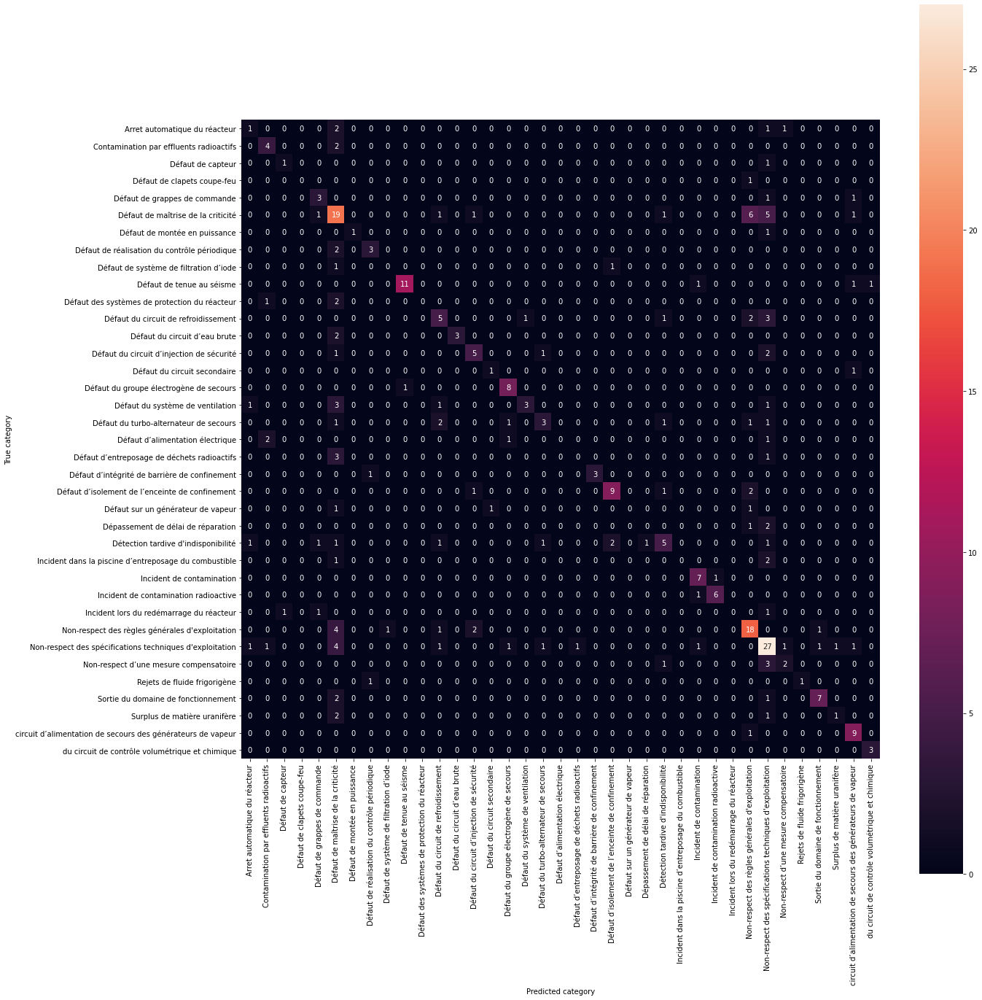

20000 features


In [53]:
model, num2code, code2num = runAllPipe(
    df_incidents,
    input_var  = 'text',
    target_var = 'topic_NMF_interpreted',
    split_col  = None,
    model_type = 'calibrated linear SVC', # 'catboost', 'linear SVC', 'calibrated linear SVC'
    vectorizer = None,
    retrain = True,
)

In [116]:
class textClassifier():
    def __init__(self, model, num2class):
        self.model = model
        self.num2class = num2class
    
    def predict(self, X):
        y = self.model.predict(X)
        y = [self.num2class[i] for i in y]
        return y

In [117]:
text_classifier = textClassifier(model, num2code)

In [118]:
# file_name = os.path.join(path_to_save, 'text_classifier.pk')
# with open(file_name, 'wb') as file:
#     dill.dump(text_classifier, file) 

In [52]:
model, num2code, code2num = runAllPipe(
    df_incidents,
    input_var  = 'text',
    target_var = 'topic_NMF_interpreted',
    split_col  = None,
    model_type = 'catboost', # 'catboost', 'linear SVC', 'calibrated linear SVC'
    vectorizer = None,
    retrain = False,
)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

The corpus totalizes 1527 sentences. 
Among these sentences, 1221 are randomly selected for training, and the remaining 306 tickets are left for testing. 

The trained model displays an accuracy of 51.0 % on the test set.

                                                             precision    recall  f1-score   support

                              Arret automatique du réacteur       0.33      0.20      0.25         5
                    Contamination par effluents radioactifs       0.67      0.67      0.67         6
                                          Défaut de capteur       0.00      0.00      0.00         2
                                Défaut de clapets coupe-feu       0.00      0.00      0.00         1
                              Défaut de grappes de commande       0.67      0.40      0.50         5
                         Défaut de maîtrise de la criticité       0.34      0.49      0.40        35
                              Défaut de montée en puissance       1.0

TypeError: '<' not supported between instances of 'list' and 'int'

<a id="ner_unsupervised"></a>

# III - Unsupervised NER

[Table of Content](#TOC)

<a id="entity_discovery"></a>

## 1. Discovery of Open-domain Entities

[Table of Content](#TOC)

In [4]:
df_incidents = pd.read_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles_topics.xlsx'))

In [7]:
# 400 MB transformer-based model
nlp = spacy.load('fr_dep_news_trf', disable = ['ner'])

### $\bullet$ Approach 1 - Chunks

In [20]:
texts = df_incidents.text.tolist()

incident_chunks = []
for i in tnrange(len(texts)):
    text = texts[i]
    chunks = nlp(text).noun_chunks
    chunks = [c for c in chunks]
    incident_chunks.append(chunks)

In [283]:
incident_chunks[42]

[Non-respect d’une consigne de maîtrise de la criticité.,
 La société Framatome,
 décembre 2020,
 un événement significatif relatif à la maîtrise du risque de de criticité[1,
 de Romans-sur-Isère,
 L’événement,
 de base,
 INB,
 d'éléments combustibles standards utilisés dans les réacteurs à eau sous pression,
 La matière nucléaire utilisée dans cette installation,
 d’enrichissement maximal,
 L’atelier de pastillage,
 la poudre d’oxyde d’uranium,
 de combustible nucléaire,
 qui,
 des combustibles nucléaires des réacteurs,
 en cours,
 il,
 la qualité des pastilles,
 une double charge d’additifs,
 du mélange,
 novembre 2020,
 Les quantités d’additifs,
 de la criticité du mélange,
 Cette double charge d’additifs,
 de dimensionnement de l’installation,
 d’incidence sur la sûreté, la sécurité des personnes ou l’environnement de l’installation,
 ceci,
 un écart au fonctionnement normal de l’installation, qui prévoit une seule dose d’additifs par mélange,
 du non-respect du référentiel de sûre

In [76]:
chunk = incident_chunks[42][3]
print(chunk)
print(chunk.lemma_)

un événement significatif relatif à la maîtrise du risque de de criticité[1
un événement significatif relatif à le maîtrise de risque de de criticité[1


In [77]:
displacy.render(chunk, style = "dep", jupyter = True)

In [58]:
df_incidents_2 = df_incidents[['text', 'title']]
df_incidents_2['chunks'] = incident_chunks

In [59]:
df_incidents_2.head()

,text,title,chunks
0,La société Framatome a déclaré le 20 avril 202...,Non-respect d’une règle de maîtrise de la crit...,"[(Non-respect, d’, une, règle, de, maîtrise, d..."
1,"Le 7 avril 2021, l’exploitant de la centrale n...",Non-respect des spécifications techniques d’ex...,"[(Non-respect, des, spécifications, techniques..."
2,La société Framatome a déclaré le 13 avril 202...,Non-respect d’une consigne de maîtrise de la c...,"[(Non-respect, d’, une, consigne, de, maîtrise..."
3,"Dans la nuit du 4 au 5 avril 2021, EDF a infor...",Incendie du transformateur principal du réacte...,"[(Incendie, du, transformateur, principal, du,..."
4,"Le 24 mars 2021, l’exploitant de la centrale n...",Détection tardive de l’indisponibilité du syst...,"[(Détection, tardive, de, l’, indisponibilité,..."


### $\bullet$ Approach 2 - Generic Named Entities

Franch models only detect PER - LOC - ORG - MISC and thus aren't satisfying, english models perform slignlty better but still very few is detected.

In [11]:
# 450 MB transformer-based model
nlp_en = spacy.load('en_core_web_trf')

# Merge multi-word entities into single tokens
#nlp_en.add_pipe("merge_entities")

In [300]:
# an example
text = df_incidents.text[42]
doc = nlp_en(text)

displacy.render(doc, style = "ent", jupyter = True)

In [196]:
#for s in doc.sents: print([(s.text, ent.text.strip(), ent.label_) for ent in s.ents])

### $\bullet$ Approach 3 - Open-domain Entities using Syntactic Dependency Graph

In [28]:
POS_roles = {
    'subject': ['NOUN', 'PRON', 'PROPN'],
    'action': ['VERB'],
    'modifier': ['ADJ', 'ADV', 'AUX', 'DET', 'NUM', 'PART', 'SYM', 'PUNCT'],
    'connector': ['ADP', 'CONJ', 'SCONJ', 'CCONJ'],
    'misc': ['INTJ', 'SPACE'],
}

In [27]:
def get_dependency_paths_from_tree(
    doc, 
    max_distance = None, 
    min_length = 2,
    start_from_leaves = False,
    start_pos = None,
    trans_pos = None,
    stop_pos = None, 
    dep = None):
    '''
    Performs bottom-up exploration of the dependency tree of tokens parsed with spacy,
    and collect paths in the oriented tree, where token part-of-speeches meet 
    the requirements and dependency meet the 'dep' requirement,
    and that are maximal with respect to these requirements.

    Parameters
    ----------
    doc: Iterable.
    output of a spacy model applied on a text.

    start_pos: list, or None.
    list of the allowed part-of-speech tags at the beginning of paths, 
    or None to allow all tags.

    trans_pos: list, or None.
    list of the allowed part-of-speech tags during tree walk, 
    or None to allow all tags.

    stop_pos: list, or None.
    list of the allowed part-of-speech tags that stop the walk in the tree, 
    or None to allow all tags.

    dep: list, or None.
    list of the allowed dependency relations, or None to allow all relations.

    Returns
    -------
    completed: list.
    The retrieved list of paths meeting the requirements in the dependency tree
    '''
    completed = []
    temporary = [
        t for t in doc 
        if (start_pos is None or t.pos_ in start_pos)
        and not (start_from_leaves and set(t.children) & set(temporary))
    ]
    temporary = [[t] for t in temporary]
    
    while temporary != []:
        checked = []
        for chain in temporary:
            word = chain[-1]
            head = word.head
            
            # token and its head are different elements
            bool1 = (word.dep_ != 'ROOT')
            
            # distance between last token and its head isn't too high
            bool2 = (max_distance is None or abs(word.i - head.i) <= max_distance) 
            
            # dependency fulfills criterion
            bool3 = (dep is None or word.dep_ in dep)
            
            # head fulfills transition criterion
            bool4 = (trans_pos is None or head.pos_ in trans_pos)
            
            # last token doesn't fulfills stopping criterion
            bool5 = len(chain) == 1 or not (stop_pos and word.pos_ in stop_pos)
            
            # accumulation step
            if (bool1 and bool2 and bool3 and bool4 and bool5):
                checked.append(chain + [head])
            else:
                completed.append(chain)
        temporary = checked

    completed = [c for c in completed if len(c) >= min_length]
    return completed


def merge_intersecting_paths(paths):
    '''
    Merge intersecting paths, or equivalently, paths sharing their root token.
    '''
    root2path = {}
    for path in paths:
        root = path[-1]
        if root in root2path:
            root2path[root].append(path)
        else:
            root2path[root] = [path]
    paths = [[t for p in ps for t in p] for ps in root2path.values()]
    return paths
    

def get_path_span(doc, path):
    imin = min([t.i for t in path])
    imax = max([t.i for t in path])
    span = doc[imin: imax+1]
    return span


def get_entity_spans(doc, extended_mwe = True, max_distance = None):
    # compute list of dependency paths
    paths = get_dependency_paths_from_tree(
        doc, 
        max_distance,
        start_pos = POS_roles['subject'] + POS_roles['modifier'],
        trans_pos = POS_roles['subject'] + POS_roles['modifier'], 
        stop_pos = (None if extended_mwe else POS_roles['subject']),
        dep = None,
    )
    # only retain paths whose root is a central, non-trivial word
    paths = [
        p for p in paths 
        if p[-1].pos_ in POS_roles['subject']
        and re.sub('[^a-zA-Z0-9]', '', p[-1].text) != ''
    ]
    # fusion paths with common root, and sort by order of appearance
    paths = merge_intersecting_paths(paths)
    paths.sort(key = lambda path : path[-1].i, reverse = True)

    # collect the entity corresponding to each path
    spans = [get_path_span(doc, path) for path in paths]
    return (paths, spans)


def get_MWE(texts, nlp, extended_mwe = True, max_distance = None):
    # init entities
    df_entities = pd.DataFrame()
    
    # loop over texts
    for i in tnrange(len(texts)):
        # parse dependency tree
        text = texts[i]
        doc = nlp(text)
        
        # collect the entity spans found in text
        paths, spans = get_entity_spans(doc, extended_mwe, max_distance)
        
        # collect the text, lemma and root of each entity
        span_texts = [span.text for span in spans]
        span_lemms = [span.lemma_ for span in spans]
        span_lcxts = [doc[span.sent.start: span.start].lemma_ for span in spans]
        span_rcxts = [doc[span.end+1: span.sent.end].lemma_ for span in spans]
        span_bools = [
            sum([(len(t)>len(text) and text in t) for t in span_texts]) == 0 
            for text in span_texts
        ]
        span_texts = [t for b, t in zip(span_bools, span_texts) if b]
        span_lemms = [l for b, l in zip(span_bools, span_lemms) if b]
        span_lcxts = [c for b, c in zip(span_bools, span_lcxts) if b]
        span_rcxts = [c for b, c in zip(span_bools, span_rcxts) if b]
        span_roots = [p[-1].lemma_ for b, p in zip(span_bools, paths) if b]

        # store result
        df_spans = pd.DataFrame({
            'text index': [i for _ in range(len(span_texts))],
            'entity': span_texts,
            'lemma': span_lemms,
            'left context': span_lcxts,
            'right context': span_rcxts,
            'root word': span_roots,
        }) 
        df_entities = pd.concat((df_entities, df_spans), axis = 0, ignore_index = True)
    return df_entities

In [170]:
texts = df_incidents.text.tolist()

#### short, word-like entities

In [21]:
df_mwe = get_MWE(texts, nlp, extended_mwe = False, max_distance = None)

In [102]:
df_mwe.shape

(106357, 4)

In [23]:
df_mwe.head()

,text index,entity,lemma,root word
0,0,la matière fissile,le matière fissile,matière
1,0,la géométrie,le géométrie,géométrie
2,0,le contrôle,le contrôle,contrôle
3,0,chaque étape,chaque étape,étape
4,0,la masse de matière présente,le masse de matière présent,masse


In [104]:
df_mwe.to_excel(os.path.join(path_to_data, 'mwe.xlsx'), index = False)

#### longer, chunck-like entities

In [84]:
df_entities = get_MWE(texts, nlp, extended_mwe = True, max_distance = None)

In [85]:
# df_entities.to_excel(os.path.join(path_to_data, 'entities.xlsx'), index = False)

In [ ]:
df_entities.shape

In [87]:
df_entities.head()

,text index,entity,lemma,left context,right context,root word
0,0,la limitation de la masse de matière présente ...,le limitation de le masse de matière présent à...,"pour prévenir ce risque , le règle général d’ ...",,limitation
1,0,les règles générales d’exploitation de l’insta...,le règle général d’ exploitation de l’ install...,"pour prévenir ce risque ,",", notamment , le limitation de le masse de mat...",règle
2,0,ce risque,ce risque,pour prévenir,le règle général d’ exploitation de l’ install...,risque
3,0,une masse de matière fissile trop importante,un masse de matière fissile trop important,1 ] le risque de criticité être définir comme ...,rassembler,masse
4,0,le risque de démarrage d’une réaction nucléair...,le risque de démarrage d’ un réaction nucléair...,1 ] le risque de criticité être définir comme,un masse de matière fissile trop important êtr...,risque


In [87]:
# text = "opérations de vidange du circuit primaire du réacteur 2 en cours"

# doc = nlp(text)
# displacy.render(doc, style = "dep", jupyter = True)

In [121]:
def check_nouns(texts, nlp):
    # loop over texts
    for i in tnrange(len(texts)):
        # parse dependency tree
        text = texts[i]
        tokens = nlp(text)
        for j in range(len(tokens)-1):
            t = tokens[j]
            n = tokens[j+1]
            h = t.head
            if t.pos_ in ['NOUN', 'PRON', 'PROPN'] and n.pos_ in ['NOUN', 'PRON', 'PROPN']:
                print('successor:', t.text, n.text)
            if t.pos_ in ['NOUN', 'PRON', 'PROPN'] and h.pos_ in ['NOUN', 'PRON', 'PROPN']:
                print('head:', h.text, t.text)
    return

In [122]:
check_nouns(texts[:3], nlp)

successor: société Framatome
head: société Framatome
head: Autorité sûreté
head: Autorité ASN
head: maîtrise risque
head: risque criticité[1].
head: usine fabrication
head: fabrication combustible
head: commune Romans-sur-Isère
head: commune Drôme
head: installation base
head: installation INB
head: installation n°
head: fabrication éléments
head: réacteurs eau
head: réacteurs pression
head: uranium matière
head: uranium uranium
head: uranium taux
head: taux enrichissement
head: particules matière
head: matière résidus
head: emplacements sol
head: opérateurs charge
head: charge opération
head: opération tamisage
head: tamisage bouteillons
successor: chariot porte-bouteillons
head: chariot porte-bouteillons
head: chariot chariot
head: type matière
head: détection anomalie
head: équipes Framatome
head: type matière
head: Compte-tenu marges
head: marges sûreté
head: risque criticité
head: conséquence travailleurs
head: travailleurs environnement
head: raison non-respect
head: non-respect 

<a id="entity_clustering"></a>

## 2. Formation of Entity categories

[Table of Content](#TOC)

In [139]:
# if necessary
df_entities = pd.read_excel(os.path.join(path_to_data, 'entities.xlsx'))
df_entities.shape

(51545, 6)

#### Perform Topic modeling on lemmatized entities without stopwords

In [44]:
# # with full vocab except stopwords
# entities = df_entities.lemma.tolist()
# (
#     df_ents_topic, 
#     df_topic_feature, 
#     df_topic_importance, 
#     df_feature_importance,
# ) = get_topic_modeling(
#     entities, 
#     method = 'LSA',
#     n_components = 250,
#     vocab = None,
#     stop_words = fr_stop,
# )

number of features : 13926


#### Perform Topic modeling on stripped ngrams

In [140]:
entities = df_entities.lemma.tolist()

ents_ngrams = get_ngrams(entities, ngram_range = 3)
print(len(ents_ngrams))

ents_ngrams = strip_ngrams_fr(ents_ngrams)
print(len(ents_ngrams))

93523
35760


In [158]:
# with reduced vocab
entities = df_entities.entity.tolist()
(
    vectorizer,
    model,
    df_ents_topic, 
    df_topic_feature, 
    df_topic_importance, 
    df_feature_importance,
) = get_topic_modeling(
    entities, 
    method = 'NMF',
    n_components = 100,
    vocab = ents_ngrams,
    stop_words = [],
    return_model = True,
)

number of features : 5375


In [159]:
ent_topic_NMF = df_ents_topic.idxmax(axis = 1)

In [143]:
df_entities['topic_NMF'] = ent_topic_NMF

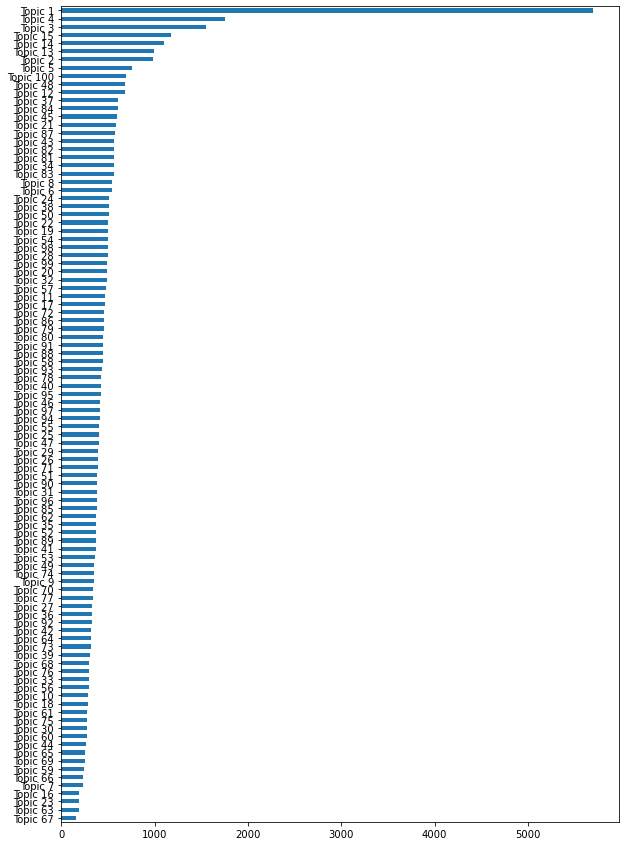

In [161]:
ent_topic_NMF.value_counts().plot.barh(figsize = (10, 15)).invert_yaxis()
plt.show()

#### Interpretation of NMF topics

In [160]:
df_entities[df_entities.topic_NMF == 'Topic 19'].entity.tolist()

['un événement significatif pour la sûreté relatif à la découverte tardive de l’indisponibilité d’un système',
 'un événement significatif relatif à la maîtrise du risque de de criticité dans son usine de Romans-sur-Isère',
 'un événement significatif pour la sûreté relatif à la détection tardive de défauts',
 'les dispositions de radioprotection des travailleurs, leur contrôle ainsi que la surveillance des intervenants extérieurs dans ses installations',
 'le technicien qualifié en radioprotection',
 'un événement significatif pour la sûreté relatif à un entreposage d’effluents liquides radioactifs dans un local de l’installation non autorisé à cet effet',
 'des raisons de radioprotection,',
 'un événement significatif relatif au non-respect du référentiel de sûreté',
 'un événement significatif pour la sûreté relatif au non-respect d’exigences',
 'un événement significatif pour la sûreté relatif à la détection tardive de l’indisponibilité d’un ventilateur du système de ventilation et

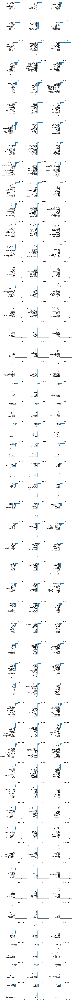

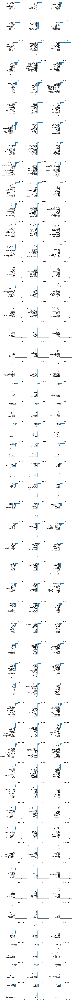

In [66]:
# NMF
plot_top_words(df_topic_feature, n_topics = 150, n_top_words = 15)

In [67]:
n_components = 150

for n in range(1, n_components + 1):
    imp = df_topic_importance['weight'][n-1]
    print('\nTopic {} (importance = {:.3f} %)'.format(n, imp * 100))
    words = get_topic_description(
        df_topic_feature, 
        n_topic = n, 
        limit = .05,
    )
    print(words)


Topic 1 (importance = 100.000 %)
[['exploitant', 7.2979]]

Topic 2 (importance = 100.000 %)
[['asn', 7.7386]]

Topic 3 (importance = 100.000 %)
[['échelle', 2.7229], ['ines', 2.5889], ['niveau de échelle', 2.4537], ['échelle ines', 2.3647], ['niveau', 2.2477]]

Topic 4 (importance = 100.000 %)
[['événement', 7.0074]]

Topic 5 (importance = 100.000 %)
[['autorité', 2.4699], ['autorité de sûreté', 2.4578], ['sûreté nucléaire', 2.4553], ['sûreté', 1.9889], ['nucléaire', 1.9057], ['nucléaire asn', 1.6115], ['sûreté nucléaire asn', 1.606]]

Topic 6 (importance = 100.000 %)
[['incident', 4.6534], ['avis', 0.279], ['avis incident', 0.2413], ['cas incident', 0.203], ['incident ou accident', 0.0687], ['déclaration incident', 0.0541]]

Topic 7 (importance = 100.000 %)
[['objet', 3.9209]]

Topic 8 (importance = 100.000 %)
[['écart', 6.3571], ['découverte de écart', 0.0806], ['origine de écart', 0.0544]]

Topic 9 (importance = 100.000 %)
[['réacteur', 17.6526], ['phenix', 0.0865], ['civaux', 0.07

[['vapeur', 6.3429], ['alimentation', 2.6852], ['alimentation de secours', 1.4419], ['secours', 1.3747], ['circuit alimentation', 0.9972], ['alimentation en eau', 0.6804], ['secours en eau', 0.635], ['gv', 0.6148], ['système alimentation', 0.4732], ['asg', 0.4454], ['système', 0.3853], ['vapeur asg', 0.3355], ['vapeur gv', 0.2224], ['turbopompe alimentation', 0.1475], ['vapeur système', 0.124], ['vapeur système asg', 0.124], ['pince', 0.1057], ['pince vapeur', 0.0889], ['alimentation en vapeur', 0.0787], ['système de secours', 0.0781], ['eau alimentation', 0.0779], ['débit alimentation', 0.0771], ['système lls', 0.0583], ['eau un générateur', 0.0577], ['circuit eau alimentation', 0.054], ['are', 0.0529]]

Topic 38 (importance = 100.000 %)
[['système', 8.6777], ['système de sauvegarde', 0.3161], ['système de surveillance', 0.2916], ['système rri', 0.2634], ['ety', 0.2514], ['ganil', 0.2346], ['rpr', 0.2308], ['système ety', 0.2142], ['informatique', 0.1874], ['système rcv', 0.169], ['sy

[['basculement', 0.4717], ['branchement', 0.4079], ['raccordement', 0.4043], ['kv', 0.3511], ['lignage', 0.325], ['ultime', 0.3144], ['étiquetage', 0.3081], ['ultime secours', 0.287], ['distribution', 0.2688], ['correction', 0.244], ['tension', 0.2271], ['fukushima', 0.2235], ['ligne', 0.2163], ['interprétation', 0.2142], ['éclairage', 0.2115], ['propre', 0.2072], ['connexion', 0.2002], ['blessé', 0.1944], ['éclairage ultime secours', 0.193], ['éclairage ultime', 0.193], ['sélecteur', 0.19], ['conduite de éclairage', 0.1818], ['raccordement électrique', 0.1799], ['linge', 0.1715], ['calcul', 0.1675], ['distribution électrique', 0.1642], ['nucléaire de fukushima', 0.1589], ['absence accident', 0.1448], ['continuité', 0.1397], ['suite de accident', 0.138], ['immédiatement', 0.1362], ['détermination', 0.1361], ['détection de erreur', 0.1345], ['tableau de distribution', 0.1327], ['fukushima daiichi', 0.1312], ['daiichi', 0.1312], ['erreur de positionnement', 0.1299], ['sélecteur électriqu

[['état', 3.2514], ['sûr', 0.7918], ['maintien', 0.7544], ['état sûr', 0.7027], ['liquide', 0.675], ['état arrêt', 0.3572], ['remise en état', 0.2472], ['adéquat', 0.1298], ['état de repli', 0.1277], ['mauvais montage', 0.1214], ['final', 0.1183], ['port', 0.1035], ['soir', 0.0799], ['ancrages', 0.0749], ['état réacteur', 0.072], ['phase liquide', 0.0704], ['avancement', 0.0701], ['eau liquide', 0.0699], ['arrêt adéquat', 0.0682], ['état arrêt normal', 0.0677], ['nak', 0.0621], ['montage', 0.062], ['état de fonctionnement', 0.0586], ['etats', 0.0575], ['unis', 0.0575], ['etats unis', 0.0575], ['état plus sûr', 0.0573], ['état de installation', 0.0573], ['état de cause', 0.0563], ['état de sûreté', 0.0517]]

Topic 65 (importance = 100.000 %)
[['pompe', 6.2278], ['charge', 1.6277], ['rcv', 0.5252], ['démontage', 0.3636], ['circuit rcv', 0.3292], ['pompe primaire', 0.325], ['écrou', 0.3076], ['aval', 0.2972], ['pompe injection', 0.2438], ['pré', 0.1948], ['graissage', 0.1557], ['pompe ind

[['bon', 3.2173], ['bon fonctionnement', 2.8843], ['fonctionnement', 2.5813], ['boremètre', 0.57], ['plage', 0.354], ['essai de bon', 0.3051], ['pesée', 0.2871], ['déroulement', 0.2729], ['cycle de fonctionnement', 0.176], ['balance', 0.1668], ['doute', 0.1615], ['vérification', 0.1533], ['dernier', 0.1499], ['cycle', 0.136], ['servomoteur', 0.13], ['non fonctionnement', 0.1218], ['disponibilité', 0.1084], ['compatible', 0.1043], ['plage de fonctionnement', 0.1009], ['chariot de pesée', 0.0998], ['krt', 0.0955], ['fortement', 0.0821], ['périodique de bon', 0.079], ['fonctionnement satisfaisant', 0.0776], ['vérifier', 0.0674], ['bon déroulement', 0.0674], ['occasion', 0.0621], ['passage', 0.0599], ['dispositif anti', 0.0548], ['anti effet chaudière', 0.0548], ['fonctionnement fortement', 0.0518], ['vérification de bon', 0.0505]]

Topic 79 (importance = 100.000 %)
[['délai', 4.0423], ['24', 1.1674], ['supérieur', 0.5726], ['maximal', 0.5601], ['dernier', 0.4977], ['délai maximal', 0.3539

[['conformité', 3.4128], ['remise', 2.8216], ['remise en conformité', 1.7974], ['vérification', 1.7676], ['remise en service', 0.7894], ['non conformité', 0.6359], ['service', 0.6292], ['corrosion', 0.3271], ['écart de conformité', 0.2913], ['totalité', 0.2101], ['mise en conformité', 0.148], ['délai de remise', 0.1479], ['campagne', 0.126], ['campagne de vérification', 0.118], ['conformité relatif', 0.0991], ['remise en fonctionnement', 0.0668], ['août 2019', 0.0657], ['conformité de ensemble', 0.056]]

Topic 93 (importance = 100.000 %)
[['fuite', 3.52], ['débit', 2.6523], ['critère', 0.9521], ['huile', 0.7261], ['cas de fuite', 0.4029], ['débit de fuite', 0.3887], ['bouchon', 0.3456], ['exemple', 0.3455], ['canal', 0.2642], ['identique', 0.2496], ['sodium', 0.24], ['tour', 0.2237], ['calcinateur', 0.1986], ['robinetterie', 0.1809], ['fuite huile', 0.1745], ['fuite eau', 0.1737], ['déformation', 0.169], ['acide', 0.1493], ['partie secondaire', 0.14], ['respect un critère', 0.1304], ['

[['puits', 1.2181], ['consigne', 1.0689], ['hauteur', 0.5712], ['couvercle', 0.5631], ['fond', 0.4834], ['mobile', 0.3821], ['puits entreposage', 0.3181], ['pose', 0.3019], ['puits de cuve', 0.2995], ['évaporateur', 0.2866], ['inspecteur', 0.2636], ['question', 0.2359], ['permis', 0.2253], ['consigne temporaire', 0.1793], ['fixe', 0.1677], ['faux', 0.1595], ['accès au puits', 0.1579], ['200', 0.1513], ['présence', 0.15], ['fond de cuve', 0.146], ['robustesse', 0.1423], ['cuve alimentation', 0.132], ['proximité', 0.1317], ['huile', 0.1218], ['caisse', 0.1208], ['évaporateur 245', 0.0993], ['évaporateur 245 200', 0.0993], ['245 200', 0.0993], ['inoxydable', 0.099], ['acier inoxydable', 0.099], ['caisse huile', 0.0988], ['245', 0.0965], ['2720', 0.092], ['écoute acoustique', 0.0871], ['écoute', 0.0871], ['acoustique', 0.0871], ['acier', 0.0842], ['cuve 2720 20', 0.083], ['2720 20', 0.083], ['cuve 2720', 0.083], ['création', 0.0785], ['accès', 0.0714], ['conduite de évaporateur', 0.0614], 

[['valeur', 3.8704], ['fréquence', 0.6926], ['valeur limite', 0.4391], ['document', 0.4288], ['résultat', 0.4129], ['courant', 0.3889], ['minimum', 0.3463], ['référence', 0.2945], ['200', 0.254], ['000', 0.248], ['produit', 0.2432], ['transmission', 0.2298], ['m3', 0.2278], ['anormalement', 0.2134], ['180', 0.2018], ['180 000', 0.1759], ['180 000 m3', 0.1759], ['000 m3', 0.1759], ['600', 0.1543], ['250', 0.1421], ['acidité', 0.1355], ['faible', 0.1293], ['101', 0.1288], ['volume minimum', 0.1143], ['partir', 0.1085], ['700', 0.0948], ['plutonium', 0.0928], ['anormalement faible', 0.0916], ['litre', 0.0912], ['hygrométrie', 0.084], ['admissible', 0.0805], ['respectivement', 0.0686], ['500', 0.0676], ['56', 0.0655], ['limite de 250', 0.0623], ['22', 0.0618], ['270', 0.0564], ['inférieur', 0.0559], ['ppm', 0.0553], ['moyenne', 0.0547], ['55', 0.0534]]

Topic 121 (importance = 100.000 %)
[['iode', 2.1578], ['rejet', 1.7621], ['efficacité', 1.2331], ['radioactif', 1.072], ['filtration', 1.0

[['phase', 1.559], ['2012', 1.4941], ['17', 0.7042], ['13', 0.6667], ['2007', 0.6621], ['arrêté', 0.6409], ['23', 0.607], ['mai', 0.5427], ['21', 0.5052], ['vue', 0.4799], ['phase de redémarrage', 0.4714], ['2008', 0.4066], ['juin', 0.391], ['canalisation', 0.3649], ['article', 0.3584], ['redémarrage', 0.316], ['décembre', 0.2673], ['poursuite', 0.2656], ['juillet', 0.2464], ['20', 0.243], ['juin 2012', 0.2391], ['septembre 2012', 0.2391], ['novembre', 0.2025], ['août 2012', 0.1737], ['juillet 2012', 0.1706], ['1999', 0.1623], ['août', 0.151], ['mai 2012', 0.1503], ['décret', 0.139], ['19', 0.1265], ['novembre 2012', 0.1219], ['mai 2008', 0.1178], ['2003', 0.1175], ['26', 0.116], ['14', 0.1139], ['icpe', 0.1102], ['décembre 2007', 0.1091], ['arrêté préfectoral', 0.1084], ['préfectoral', 0.1084], ['juin 2008', 0.1055], ['juillet 2008', 0.0999], ['20 mai', 0.0957], ['2012 le réacteur', 0.0946], ['mai 2010', 0.0938], ['décret 2007', 0.0883], ['mai 2011', 0.0875], ['mars 2012', 0.0813], ['

[['ines échelle', 2.0816], ['échelle ines échelle', 2.0076], ['procédure', 1.8143], ['quantité', 1.3347], ['turbo', 1.2085], ['alternateur', 0.8571], ['classement', 0.8174], ['turbo alternateur', 0.5945], ['quantité eau', 0.5887], ['instant', 0.5358], ['alternateur de secours', 0.4435], ['relâchement', 0.1656], ['lls', 0.1543], ['classement au niveau', 0.1301], ['nouveau classement', 0.1198], ['relâchement de radioactivité', 0.1069], ['alternateur lls', 0.1063], ['turbo alternateur lls', 0.1063], ['radioactivité', 0.0938], ['nécessaire', 0.0837], ['surveillance de environnement', 0.0791], ['second temps', 0.0773], ['faible quantité', 0.0768], ['transgression', 0.0768], ['groupe turbo alternateur', 0.0605], ['groupe turbo', 0.0605], ['niveau de ines', 0.0595], ['nécessaire au fonctionnement', 0.0561]]

Topic 149 (importance = 100.000 %)
[['local', 1.9648], ['partie', 1.8368], ['déclaration', 1.6259], ['réglage', 1.5702], ['action', 1.3761], ['remplacement', 1.2721], ['mauvais', 1.255], 

Topic importance curve

<AxesSubplot:>

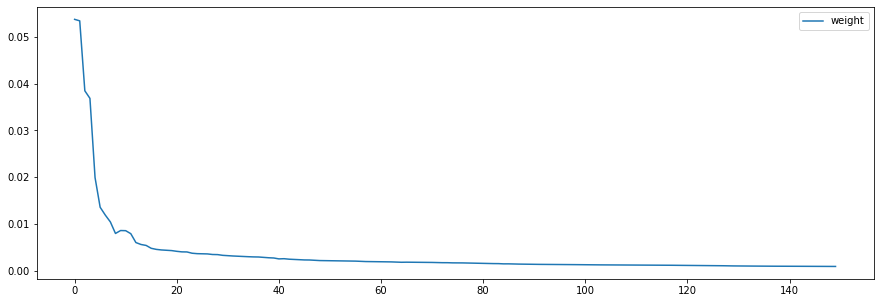

In [93]:
df_topic_importance.plot(figsize = (15, 5))

#### Export result

In [97]:
df_entities.head(40)

,text index,entity,lemma,left context,right context,root word,topic_LSA
0,0,la limitation de la masse de matière présente ...,le limitation de le masse de matière présent à...,"pour prévenir ce risque , le règle général d’ ...",,limitation,Topic 75
1,0,les règles générales d’exploitation de l’insta...,le règle général d’ exploitation de l’ install...,"pour prévenir ce risque ,",", notamment , le limitation de le masse de mat...",règle,Topic 14
2,0,ce risque,ce risque,pour prévenir,le règle général d’ exploitation de l’ install...,risque,Topic 57
3,0,une masse de matière fissile trop importante,un masse de matière fissile trop important,1 ] le risque de criticité être définir comme ...,rassembler,masse,Topic 75
4,0,le risque de démarrage d’une réaction nucléair...,le risque de démarrage d’ un réaction nucléair...,1 ] le risque de criticité être définir comme,un masse de matière fissile trop important êtr...,risque,Topic 35
5,0,ordre croissant de gravité,ordre croissant de gravité,en raison de non-respect de référentiel de sûr...,,ordre,Topic 23
6,0,niveau 1 de l’échelle INES (échelle internatio...,niveau 1 de l’ échelle ine ( échelle internati...,en raison de non-respect de référentiel de sûr...,de 0 à 7 par ordre croissant de gravité ),niveau,Topic 3
7,0,l’incident,l’ incident,en raison de non-respect de référentiel de sûr...,être classer au niveau 1 de l’ échelle ine ( é...,incident,Topic 6
8,0,raison du non-respect du référentiel de sûreté...,raison de non-respect de référentiel de sûreté...,en,l’ incident avoir être classer au niveau 1 de ...,raison,Topic 57
9,0,de conséquence sur les travailleurs ou sur l’e...,de conséquence sur le travailleur ou sur l’ en...,compte-tenu de marge de sûreté retenir vis-à-v...,,conséquence,Topic 15


In [99]:
df_entities.to_excel(os.path.join(path_to_data, 'entities_with_topics.xlsx'), index = False)

<a id="entity_recognition_unsupervised"></a>

## 3. Unsupervised Recognition of Named Entities

[Table of Content](#TOC)

In [127]:
class unsupervizedEntityClassifier():
    def __init__(self, vectorizer, model, vocab = None, method = 'LSA', topic_dict = None):
        self.vectorizer = vectorizer
        self.model = model
        self.vocab = vocab
        self.method = method
        self.components = model.components_.shape[0]
        topic_dict = {i: 'Entity {}'.format(i) for i in range(1, self.components+1)} if not topic_dict else topic_dict
        self.set_topics(topic_dict)

    def set_topics(self, topic_dict):
        self.topic_dict = topic_dict
        self.idx2key = {i: k for i, k in enumerate(self.topic_dict.keys())}
        return

    def explain_topics(self, n_top_words = 15):
        features = self.vectorizer.get_feature_names()
        if self.vocab:
            features = [w for w in features if w in self.vocab]

        # (topic * feature) matrix
        df_topic_feature = pd.DataFrame(np.round(self.model.components_, 4))
        df_topic_feature.columns = features
    
        n_row_plots = int((self.components-0.1)/3)+1
        fig, axes = plt.subplots(n_row_plots, 3, figsize = (25, 8*n_row_plots), sharex = True)
        axes = axes.flatten()
        for topic_idx, topic in enumerate(df_topic_feature.values):
            top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
            top_features = [features[i] for i in top_features_ind]
            weights = topic[top_features_ind]

            ax = axes[topic_idx]
            ax.barh(top_features, weights, height = 0.7)
            ax.set_title(f'Topic {topic_idx+1}', fontdict = {'fontsize': 30})
            ax.invert_yaxis()
            ax.tick_params(axis = 'both', which = 'major', labelsize = 20)
            for i in 'top right left'.split():
                ax.spines[i].set_visible(False)

        plt.subplots_adjust(top = 0.90, bottom = 0.05, wspace = 0.90, hspace = 0.3)
        plt.show()
        return
        
    def vectorize(self, X):
        vects = self.vectorizer.transform(X)
        feats = self.vectorizer.get_feature_names()
        if self.vocab:
            feats = [i for i, w in enumerate(feats) if w in self.vocab]
            vects = vects[:, feats]
        return vects
    
    def predict(self, X):
        X = self.vectorize(X)
        y = self.model.transform(X)
        y = y[:, [k-1 for k in self.topic_dict.keys()]]
        probas = y.max(axis = 1)
        labels = y.argmax(axis = 1)
        labels = [self.topic_dict[self.idx2key[l]] for l in labels]
        output = [(l, p) for l, p in zip(labels, probas)]
        return output



def fit_unsupervized_entity_classifier(
    texts, 
    method = 'LSA', 
    n_components = None, 
    vocab = None,
    stop_words = [],
):
    if method not in ['PCA', 'LSA', 'LDA', 'NMF']:
        print('Invalid method (choose between PCA, LSA, LDA and NMF)')
        return

    # fit (text * feature) matrix
    vectorizer = TfidfVectorizer(
        sublinear_tf = False,
        ngram_range = (1, 3),
        min_df = 3,
        stop_words = stop_words,
        strip_accents = None,
        lowercase = True,
    )
    vects = vectorizer.fit_transform(texts) # size (num_texts, num_features)
    feats = vectorizer.get_feature_names()
    
    # reduce feature size
    if vocab:
        feats = [i for i, w in enumerate(feats) if w in vocab]
        vects = vects[:, feats]

    # fit (text * topic) matrix
    if method == 'PCA' : 
        model = PCA(
            n_components = n_components, 
            random_state = 42)
        model = model.fit(vects.todense())
        
    elif method == 'LSA' : 
        model = TruncatedSVD(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            random_state = 42)
        model = model.fit(vects)
        
    elif method == 'LDA' : 
        model = LatentDirichletAllocation(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            random_state = 42)
        model = model.fit(vects)

    elif method == 'NMF':
        model = NMF(
            n_components = (n_components if n_components else min(vects.shape)-1), 
            beta_loss = 'kullback-leibler', 
            solver = 'mu', 
            #alpha = .1,
            #l1_ratio = .0,
            random_state = 42)
        model = model.fit(vects)
    
    # ship into pipeline
    pipeline = unsupervizedEntityClassifier(vectorizer, model, vocab, method)
    return pipeline

#### Fit unsupervized entity classifier

In [122]:
# if necessary
df_entities = pd.read_excel(os.path.join(path_to_data, 'entities.xlsx'))
df_entities.shape

(51545, 6)

In [123]:
entities = df_entities.lemma.tolist()

ents_ngrams = get_ngrams(entities, ngram_range = 3)
print(len(ents_ngrams))

ents_ngrams = strip_ngrams_fr(ents_ngrams)
print(len(ents_ngrams))

93523
35760


In [134]:
unsupervized_entity_classifier = fit_unsupervized_entity_classifier(
    entities, 
    method = 'LSA', 
    n_components = 150, 
    vocab = ents_ngrams,
    stop_words = [],
)

In [282]:
# file_name = os.path.join(path_to_save, 'LSA_entity_classifier_base.pk')
# with open(file_name, 'wb') as file:
#     dill.dump(unsupervized_entity_classifier, file) 

In [162]:
unsupervized_entity_classifier = unsupervizedEntityClassifier(
    vectorizer, 
    model, 
    vocab = ents_ngrams, 
    method = 'NMF',
)

In [163]:
# file_name = os.path.join(path_to_save, 'NMF_entity_classifier_base.pk')
# with open(file_name, 'wb') as file:
#     dill.dump(unsupervized_entity_classifier, file)

#### Visualisation of Entities

In [57]:
def add_entity_spans_to_tokens(doc, spans_preds):
    for span, pred in spans_preds:
        try:
            #tokens.set_ents([Span(tokens, span.start, span.end, pred)])
            doc.ents += (Span(doc, span.start, span.end, pred),)
        except:
            print('Issue with "{}" from pos. {} to {}'.format(span.text, span.start, span.end))
    return doc


def shift_ents(doc, doc2, labels, verbose = False):
    shifted_ents = [
        (span.start_char, span.end_char, span.label_) 
        for span in doc2.ents if span.label_ in labels
    ]
    if verbose: 
        print(shifted_ents)
    shifted_ents = [
        (doc.char_span(start_idx = span[0], end_idx = span[1]), span[2]) 
        for span in shifted_ents
    ]
    doc = add_entity_spans_to_tokens(doc, shifted_ents)
    return doc


# taken from https://github.com/explosion/spacy-streamlit/blob/9592a27645f9bdb0c02c6add02838a506a0aaccf/spacy_streamlit/util.py#L26
def get_html(html: str):
    """Convert HTML so it can be rendered."""
    WRAPPER = """<div style="overflow-x: auto; border: 1px solid #e6e9ef; border-radius: 0.25rem; padding: 1rem; margin-bottom: 2.5rem">{}</div>"""
    # Newlines seem to mess with the rendering
    html = html.replace("\n", " ")
    return WRAPPER.format(html)



def get_and_display_entities(
    doc, 
    clf, 
    extended_mwe = True, 
    max_distance = None,
    threshold = .1,
    color = '#84bee8', # blue
    ):
    # extract entities
    paths, spans = get_entity_spans(doc, extended_mwe = True, max_distance = None)

    # classify entities
    texts = [ent.lemma_ for ent in spans]
    preds = clf.predict(texts)
    spans_preds = [(e, p[0]) for e, p in zip(spans, preds) if p[1]>= threshold]
    
    # get text with entity spans and predicted classes as html
    doc = add_entity_spans_to_tokens(doc, spans_preds)
    
    # display html
    topic2color = {topic: color for topic in clf.topic_dict.values()}
    doc_html = displacy.render(
        doc, 
        style = "ent", 
        jupyter = False,
        options = {'colors': topic2color},
    )
    doc_html = get_html(doc_html)
    return doc_html

In [9]:
texts = df_incidents.text.tolist()

In [66]:
num_incident = 0

doc_en = nlp_en(texts[num_incident])
doc = nlp(texts[num_incident])
doc = shift_ents(doc, doc_en, labels = ['GPE', 'DATE'])

text_html = get_and_display_entities(
    doc, 
    unsupervized_entity_classifier, 
    extended_mwe = True, 
    max_distance = None,
    threshold = .05,
)

In [67]:
display(HTML(text_html))

<a id="entity_interpretation"></a>

## 4. Category interpretation

[Table of Content](#TOC)

In [132]:
# if necessary
df_entities = pd.read_excel(os.path.join(path_to_data, 'entities_with_topics.xlsx'))
df_entities.shape

(51545, 7)

In [291]:
LSA_topic_dict = {
    4: 'Criticité',
    9: 'Anomalie : Ecart',
    11: 'Matériel impacté',
    13: 'Matériel impacté',
    21: "Matériel impacté",
    24: 'Durée',
    25: 'Anomalie',
    39: "Matériel impacté",
    42: 'Localisation',
    47: 'Matériel impacté',
    49: 'Matériel impacté',
    52: 'Matériel impacté',
    54: "Matériel impacté",
    59: 'Durée',
    73: 'Anomalie : Dépassement de seuil',
}
    
#     28: 'Localisation : Vanne',
#     31: "Localisation : Circuit d'injection",
#     34: 'Localisation : Enceinte de confinement',
#     37: "Localisation : Circuit d'injection",
#     38: "Localisation : Salle de commande",
#     39: "Localisation : Salle de commande",
#     40: 'Localisation : Batiment',
#     42: 'Anomalie : Ecart',
#     43: "Localisation : Circuit de refroidissement",
#     45: "Localisation : Alimentation électrique",
#     46: 'Localisation : Centrale',
#     52: 'Durée',
#     55: 'Anomalie',
#     59: 'Durée',
#     71: 'Anomalie : Contamination',
#     72: 'Anomalie : Ecart',
#     74: 'Anomalie : Contamination',
#     80: 'Anomalie : Etanchéité',
#     83: 'Anomalie : Dépassement de seuil',
#     85: 'Localisation : Voies',
#     86: 'Localisation : Voies',
#     89: 'Anomalie : Panne/Disfonctionnement',
#     90: 'Anomalie : Panne/Disfonctionnement',
#     93: 'Anomalie : Fuite',
#     95: "Localisation : Atelier",
#     96: "Localisation : Atelier",
#     103: 'Durée',
#     109: 'Localisation : Centrale',
#     119: 'Anomalie : Température',
#     120: 'Anomalie : Température',
#     123: 'Durée',
#     129: 'Anomalie : Panne/Disfonctionnement',
#     132: 'Anomalie : Expédition',
#     134: 'Anomalie : Expédition',
#     140: 'Anomalie : Température',
#     149: 'Localisation : Local',
# }

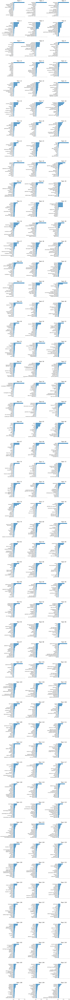

In [257]:
# LSA
unsupervized_entity_classifier.explain_topics(n_top_words = 15)

In [292]:
unsupervized_entity_classifier.set_topics(LSA_topic_dict)

In [293]:
num_incident = 2

doc = nlp(texts[num_incident])
text_html = get_and_display_entities(
    doc, 
    unsupervized_entity_classifier, 
    extended_mwe = True, 
    max_distance = None,
    threshold = .15,
    color = '#ff6e70', # red
)

In [294]:
display(HTML(text_html))

In [295]:
# file_name = os.path.join(path_to_save, 'LSA_entity_classifier_interpretated.pk')
# with open(file_name, 'wb') as file:
#     dill.dump(unsupervized_entity_classifier, file) 

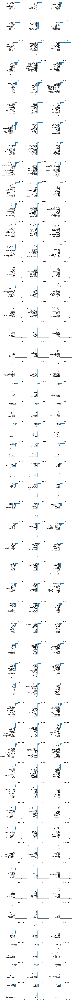

In [154]:
#NMF
unsupervized_entity_classifier.explain_topics(n_top_words = 15)

In [60]:
NMF_topic_dict = {
    3: "Criticité",
    #8: "Ecart aux règles",
    #14: "RGE/STE",
    19: "Thématique générale",
    #21: "Situation accientelle",
    # 24
    #27: "RGE/STE",
    #29: "RGE/STE",
    #30: "RGE/STE",
}

In [61]:
unsupervized_entity_classifier.set_topics(NMF_topic_dict)

In [64]:
num_incident = 2

doc_en = nlp_en(texts[num_incident])
doc = nlp(texts[num_incident])
doc = shift_ents(doc, doc_en, labels = ['GPE', 'DATE'])

text_html = get_and_display_entities(
    doc, 
    unsupervized_entity_classifier, 
    extended_mwe = True, 
    max_distance = None,
    threshold = .05,
)

In [65]:
display(HTML(text_html))

In [166]:
# file_name = os.path.join(path_to_save, 'NMF_entity_classifier_interpretated.pk')
# with open(file_name, 'wb') as file:
#     dill.dump(unsupervized_entity_classifier, file) 

#### Criticity

In [156]:
def is_critical(row, non_critical = []):
    ent = row.lemma
#     print(ent)
#     print(len(re.findall('niveau \d{1}', ent)))
    is_topic3 = row.topic_LSA == 'Topic 3'
    is_niveau = len(re.findall('niveau \d{1}', ent))>0
    is_critic = (ent not in non_critical)
    return (is_topic3 and is_niveau and is_critic)

In [175]:
entities = df_entities.groupby('lemma').apply(lambda g: (len(g), g.index.tolist(), g.lemma, g.topic_LSA))

In [158]:
num_topic = 3
entities = df_entities[df_entities.topic_LSA == 'Topic {}'.format(num_topic)]
entities['critical'] = entities.apply(lambda r: is_critical(r), axis = 1)
entities = entities[entities.critical == True]
entities.shape

(1498, 8)

In [160]:
for count, idxs, lemma, topic in entities: 
    is_topic3 = (topic == 'Topic 3')
    is_niveau = len(re.findall('niveau \d{1}', lemma))>0
    if is_topic3 and is_niveau:
        print(c, '--', e, '\n', idx, '\n')

1 -- - au niveau 1 de l’ échelle INES pour le réacteur de le centrale nucléaire de Chinon . 
 226 

1 -- - au niveau 2 de l’ échelle INES pour le réacteur de le centrale nucléaire de Saint-Laurent-des-Eaux ; 
 227 

1 -- 2011 : reclassement au niveau 7 sur l’ échelle ine par le autorité japonais de le accident nucléaire de Fukushima . 
 1092 

1 -- ce vanne thermostatique être à le origine de un incident générique détecter sur le cnpe de Tricastin le 23 octobre 2008 et classer au niveau 1 de le échelle ine . 
 1310 

1 -- ce événement significatif , qui avoir initialement être classer au niveau 0 de l’ échelle INES en 2017 , 
 143 

1 -- ce événement significatif pour le sûreté au niveau 1 de le échelle international de événement nucléaire INES 
 1437 

1 -- ce événement significatif pour le sûreté au niveau 1 de l’ échelle INES 
 466 

1 -- compte tenir de le défaillance simultané , pendant 6 heure puis 15 heure , de deux voie de circuit de refroidissement de le piscine d’ entreposage

In [ ]:
non_critical = [
    1182, 1357, 
]

<a id="entity_recognition_supervised"></a>

## 5. Supervised Recognition of Named Entities

[Table of Content](#TOC)

<a id="sim"></a>

# IV - Text Similarity

[Table of Content](#TOC)

In [ ]:
# if necessary
df_incidents = pd.read_excel(os.path.join(path_to_data, 'data_nuclear_incidents_with_titles_topic.xlsx'))

<a id="sim_tfidf"></a>

## 1. Tf-idf Text similarity

[Table of Content](#TOC)

In [471]:
def get_tfidf(texts, min_df = 1) :
    '''Returns the ticket-ticket correlation matrix for each machine,
       sorted by time and with lower tringular values only.
    '''
    tfidf = TfidfVectorizer(
        sublinear_tf = True,
        ngram_range = (1, 3),
        stop_words = [],
        min_df = min_df,
        lowercase = True,
    ).fit(texts)
    return tfidf


def get_correlations_by_key(key2tfidf) :
    '''
    Returns the ticket-ticket correlation matrix for each machine,
    sorted by time and with lower tringular values only.
    '''
    key2corrs = {}
    
    for key1, vects1 in key2tfidf.items():
        key2corrs[key1] = {}
        vects1 = normalize(vects1)     # size (num_texts1, num_features)
        for key2, vects2 in key2tfidf.items():
            vects2 = normalize(vects2) # size (num_texts2, num_features)            
            corrs = vects1 * vects2.T  # size (num_texts1, num_texts2)
            corrs = corrs.toarray()
            #corrs = np.tril(corrs, k = -1)
            #corrs = np.flip(corrs, axis = 0)
            key2corrs[key1][key2] = corrs
    return key2corrs


def get_correlations(key2tfidf) :
    '''
    Returns the ticket-ticket correlation matrix for each machine,
    sorted by time and with lower tringular values only.
    '''
    vects = vstack(key2tfidf.values())
    vects = normalize(vects)           # size (num_texts, num_features)
    corrs = vects * vects.T            # size (num_texts, num_texts)
    corrs = corrs.toarray()
    return corrs


def get_correlations_plot(corrs, x_labels = None, y_labels = None, incident_idx = None, legend = '') :
    '''Returns a triangular heatmap of correlations between incidents'''
    
    vmin = np.min(corrs)
    vmax = np.max(corrs)
    
    if incident_idx is not None :
        x_labels = x_labels if x_labels else list(range(1, corrs.shape[1] + 1))
        y_labels = [incident_idx]
        corrs = corrs[[incident_idx], :]
    else :
        x_labels = x_labels if x_labels else list(range(1, corrs.shape[1] + 1))
        y_labels = y_labels if y_labels else list(range(1, corrs.shape[0] + 1)) 

    xshape = int(corrs.shape[1]/2)+1
    yshape = max(5, int(corrs.shape[0]/2)+1)
    
    fig = plt.figure(figsize = (xshape, yshape))
    cmap = sns.diverging_palette(220, 10, as_cmap = True) #"BuPu"
    hm = sns.heatmap(
        corrs, 
        vmin = vmin, 
        vmax = vmax,
        xticklabels = x_labels,
        yticklabels = y_labels,
        cmap = cmap, 
        square = True,
        linewidth = .15, 
        cbar_kws = {"shrink": .5},
    )
    hm.invert_yaxis()
    hm.xaxis.tick_top()
    if legend : hm.set_title(legend + '\n\n')
    return fig

In [472]:
class Corrélateur(object) :
    def __init__(self, df, text_column, key_column, min_df = 1, entities = None):
        
        # get clean texts
        self.df = df
        self.text_column = text_column
        self.key_column = key_column
        self.keys = df[key_column].unique().tolist()
        self.key2df = {k: df[df[key_column] == k] for k in self.keys}
        self.key2texts = {k: v[text_column].tolist() for k, v in self.key2df.items()}
        
        # similarities computed on plain tickets
        self.vectorizer = get_tfidf(df[text_column].tolist(), min_df = min_df)
        self.key2tfidf = {k: self.vectorizer.transform(v) for k, v in self.key2texts.items()}
        self.key2corrs = get_correlations_by_key(self.key2tfidf)
        self.corrs = get_correlations(self.key2tfidf)
        
    def display_text(self, key, incident_num):
        ticket = self.key2texts[key][incident_num-1]
        print('Incident n° ' + str(incident_num))
        print(ticket)
        return

    def get_correlations_plot(self, key1 = None, key2 = None, incident_num = None):
        if incident_num:
            incident_idx = incident_num-1
            key1 = self.df[self.key_column][incident_idx]
            relative_idx = self.key2df[key1].index.tolist().index(incident_idx)
        else:
            relative_idx = None
        
        # inter-key similarities
        if (key1 and key2):
            corrs = self.key2corrs[key1][key2]
            x_labels = [i+1 for i in self.key2df[key2].index.tolist()]
            y_labels = [i+1 for i in self.key2df[key1].index.tolist()]
            legend = (
                (key1 + ' : incident n° ' + str(incident_num) + '\n versus \n ' + key2) 
                if incident_num else key1 + ' (vertical)\n versus \n' + key2 + ' (horizontal)'
            )
            hm = get_correlations_plot(corrs, x_labels, y_labels, relative_idx, legend)
        
        # intra-key similarities
        elif (key1 or key2):
            key = (key1 if key1 else key2)
            corrs = self.key2corrs[key][key]
            x_labels = [i+1 for i in self.key2df[key].index.tolist()]
            y_labels = [i+1 for i in self.key2df[key].index.tolist()]
            legend = (
                (key + ' : incident n° ' + str(incident_num)) 
                if incident_num else key
            )
            hm = get_correlations_plot(corrs, x_labels, y_labels, relative_idx, legend)
        else:
            print('Invalid input')
        return hm

    def get_most_similar(self, incident_num, key2 = None, topk = 1):
        incident_idx = incident_num-1
        key1 = self.df[self.key_column][incident_idx]
        key2 = key2 if key2 else key1

        key1_idxs = self.key2df[key1].index.tolist()
        key2_idxs = self.key2df[key2].index.tolist()
        relative_idx = key1_idxs.index(incident_idx)

        corrs = self.key2corrs[key1][key2]

        # retrieve top most similar tickets
        idxs = np.flip(np.argsort(corrs[relative_idx, :]))[1:topk+1].tolist()
        texts = [self.key2texts[key2][i] for i in idxs]
        sims = corrs[relative_idx, idxs].tolist()
        idxs = [key2_idxs[i]+1 for i in idxs]
            
        return (idxs, texts, sims)

In [473]:
correlateur = Corrélateur(
    df_incidents, 
    text_column = 'text', 
    key_column = 'location',
)

In [466]:
correlateur.keys

['Romans-sur-Isère',
 'Belleville-sur-Loire',
 'Paluel',
 'Saint-Laurent-des-Eaux',
 'Flamanville',
 'Cadarache',
 'Saclay',
 'Marseille',
 'Civaux',
 'Tricastin',
 'Marcoule',
 'Cattenom',
 'Bugey',
 'Cruas-Meysse',
 'Gravelines',
 'Chinon',
 'Inconnu',
 'Belleville',
 'Nogent',
 'Dampierre-en-Burly',
 'La Hague',
 'Pouzauges',
 'Blayais',
 'Chooz',
 'Aucun',
 'Fukushima',
 'Saint',
 'Fessenheim',
 'Penly',
 'France',
 'Cruas',
 'Golfech',
 'Fontenay-aux-Roses',
 'Dampierre',
 'Saint-Alban',
 'Grenoble',
 'Pierrelatte',
 'Bollène',
 'Narbonne',
 'Dagneux',
 'Areva NC',
 'Isère',
 'Dessel',
 'Dunkerque',
 'Canada',
 'CODOLET',
 'Manche',
 'Lyon',
 'Paris',
 'Drôme',
 'Gard',
 'Espagne']

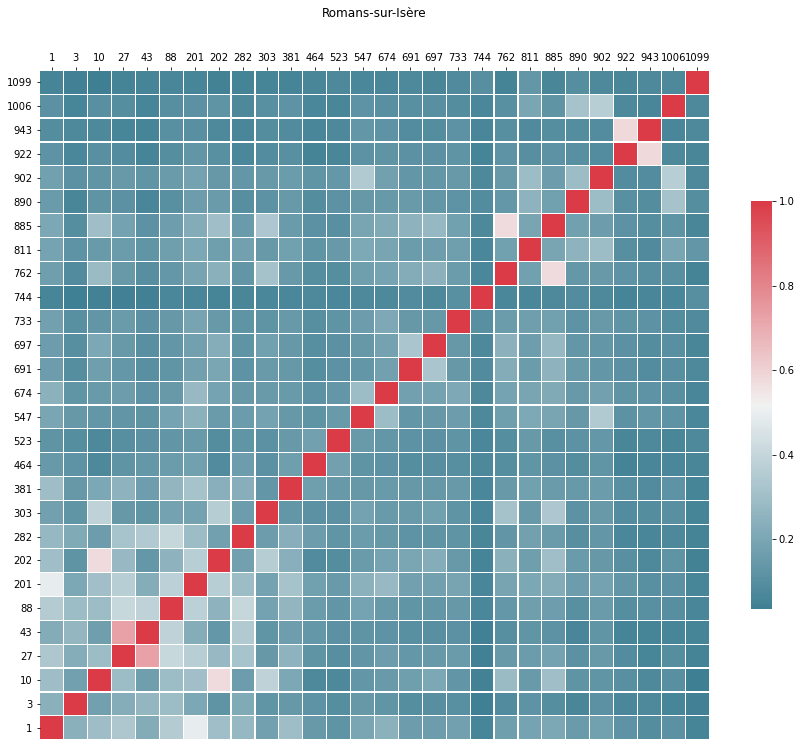

In [474]:
fig = correlateur.get_correlations_plot(key1 = 'Romans-sur-Isère')

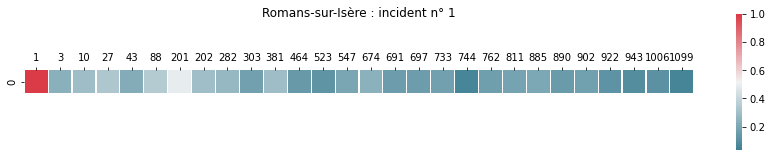

In [468]:
fig = correlateur.get_correlations_plot(incident_num = 1)

In [469]:
correlateur.key2texts['Romans-sur-Isère'][0]

"La société Framatome a déclaré le 20 avril 2021à l’Autorité de sûreté nucléaire (ASN) un événement significatif relatif à la maîtrise du risque de criticité[1].\nL’événement est survenu dans l’usine de fabrication de combustible située sur la commune de Romans-sur-Isère (Drôme), dans l’installation nucléaire de base (INB) n° 98, dédiée à la fabrication d'éléments combustibles standards utilisés dans les réacteurs à eau sous pression. La matière nucléaire utilisée dans cette installation est de l'uranium à un taux d’enrichissement maximal de 5 %.\nDans cette installation, un réseau centralisé permet d’aspirer les particules fines de matière uranifère présente dans les équipements. Cette matière doit ensuite être tamisée afin de séparer la matière uranifère réutilisable des autres résidus collectés. Avant tamisage, la matière est entreposée en bouteillons, sur des emplacements dédiés et verrouillés au sol. Ces bouteillons doivent ensuite être transportés unitairement.\nLe 19 avril 2021,

In [470]:
idxs, texts, sims = correlateur.get_most_similar(incident_num = 1, topk = 5)

# display tickets and similarity scores
for i, text, sim in zip(idxs, texts, sims) :
    print('Incident n° '+str(i) + ' has {:.2f} % similarity '.format(sim * 100))
    print('Content :')
    print(text)
    print('\n')

Incident n° 201 has 49.34 % similarity 
Content :
La société Framatome a déclaré le 17 juillet 2019 à l’ASN un événement significatif relatif à la maîtrise du risque de criticité1.
L’événement est survenu dans l’usine de fabrication de combustible située sur la commune de Romans-sur-Isère (Drôme), dans l’installation nucléaire de base (INB) n° 98, dédiée à la fabrication d'éléments combustibles standards utilisés dans les réacteurs à eau sous pression. La matière nucléaire utilisée dans cette installation est de l'uranium à un taux d’enrichissement maximal de 5 %.
Dans cette installation, certaines catégories de matière uranifère du processus de fabrication sont conditionnées dans des conteneurs de type « bouteillons », qui sont ensuite entreposés soit directement au sol, soit en chariots porte-bouteillons sur des emplacements balisés.
Le 12 juillet 2019, un opérateur a détecté lors d’une ronde la présence d’un chariot de matières nucléaires entreposé en dehors d’un emplacement dédié.


<a id="bottom"></a>

[Table of content](#TOC)